# Import Libraries

In [45]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import warnings
warnings.simplefilter(action='ignore', category=FutureWarning)
import seaborn as sns
from imblearn.over_sampling import SMOTE
import lightgbm as lgb
from scipy import stats
from sklearn.utils import resample
from sklearn.preprocessing import LabelEncoder
from sklearn.experimental import enable_iterative_imputer
from sklearn.impute import IterativeImputer
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestClassifier
from xgboost import XGBClassifier
from sklearn.metrics import roc_auc_score , classification_report , accuracy_score , confusion_matrix 
from statsmodels.stats.outliers_influence import variance_inflation_factor
from statsmodels.tools.tools import add_constant
from sklearn.linear_model import LogisticRegression
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import GradientBoostingClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn import metrics 
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis
from sklearn.model_selection import GridSearchCV
import catboost as cb
import tensorflow as tf
from keras import callbacks
from keras.layers import Dense, Input, Dropout, Normalization, BatchNormalization
from keras.models import Model, Sequential
from keras.callbacks import ModelCheckpoint, EarlyStopping, ReduceLROnPlateau
tf.random.set_seed(42)
from imblearn.under_sampling import RandomUnderSampler
from sklearn.model_selection import RandomizedSearchCV

# Data Cleaning

## Load the dataset
This dataset is taken from the Kaggle page 'https://www.kaggle.com/datasets/jsphyg/weather-dataset-rattle-package/data'.

This dataset comprises about 10 years of daily weather observations from numerous locations across Australia. The observations were gathered from a multitude of weather stations. You can access daily observations from 'http://www.bom.gov.au/climate/data'.

In [46]:
# Load the dataset into a dataframe
df = pd.read_csv('heart.csv')

## Information about the data
Let's see the first 5 rows of the dataset.

In [47]:
df.head()

,Age,Sex,ChestPainType,RestingBP,Cholesterol,FastingBS,RestingECG,MaxHR,ExerciseAngina,Oldpeak,ST_Slope,HeartDisease
0,40,M,ATA,140,289,0,Normal,172,N,0.0,Up,0
1,49,F,NAP,160,180,0,Normal,156,N,1.0,Flat,1
2,37,M,ATA,130,283,0,ST,98,N,0.0,Up,0
3,48,F,ASY,138,214,0,Normal,108,Y,1.5,Flat,1
4,54,M,NAP,150,195,0,Normal,122,N,0.0,Up,0


Now, we can plot the features of this dataset. In particular, we can understand that the target column is **RainTomorrow**. So, in the *Machine Learning* part we are going to predict this column.

In [48]:
df.columns

Index(['Age', 'Sex', 'ChestPainType', 'RestingBP', 'Cholesterol', 'FastingBS',
       'RestingECG', 'MaxHR', 'ExerciseAngina', 'Oldpeak', 'ST_Slope',
       'HeartDisease'],
      dtype='object')

We can print the shape of the dataset

In [49]:
number_of_rows = df.shape[0]
number_of_features = df.shape[1]
print(f'The dataset contains {number_of_rows} rows')
print(f'The dataset contains {number_of_features} columns')

The dataset contains 918 rows
The dataset contains 12 columns


## Data Cleaning
We can now focus our attention on the data cleaning part in order to discover:
- **NaN values**
- **Outliers**
- **Multicollinearity Problem**

Firstly, we can plot the number of unique values.

In [50]:
for col in df.columns:
    unique_values = df[col].unique()
    print(f"Column '{col}' has {len(unique_values)} unique values")

Column 'Age' has 50 unique values
Column 'Sex' has 2 unique values
Column 'ChestPainType' has 4 unique values
Column 'RestingBP' has 67 unique values
Column 'Cholesterol' has 222 unique values
Column 'FastingBS' has 2 unique values
Column 'RestingECG' has 3 unique values
Column 'MaxHR' has 119 unique values
Column 'ExerciseAngina' has 2 unique values
Column 'Oldpeak' has 53 unique values
Column 'ST_Slope' has 3 unique values
Column 'HeartDisease' has 2 unique values


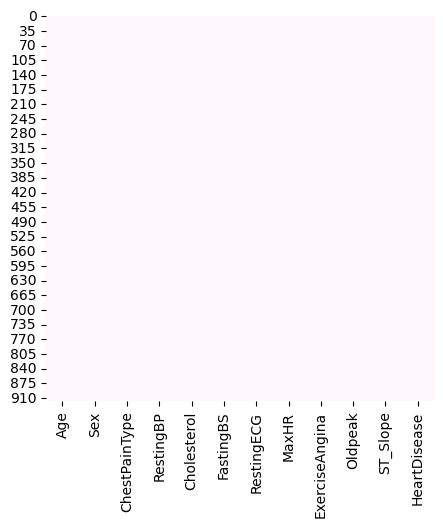

In [51]:
plt.figure(figsize=(5,5))
sns.heatmap(df.isnull(), cbar=False, cmap='PuBu')
plt.show()

In [52]:
# create a table with data missing 
missing_values = df.isnull().sum() # missing values

percent_missing = df.isnull().sum()/df.shape[0]*100 # missing value %

value = {
    'missing_values ':missing_values,
    'percent_missing %':percent_missing , 
     'data type' : df.dtypes
}
frame=pd.DataFrame(value)
frame

,missing_values,percent_missing %,data type
Age,0,0.0,int64
Sex,0,0.0,object
ChestPainType,0,0.0,object
RestingBP,0,0.0,int64
Cholesterol,0,0.0,int64
FastingBS,0,0.0,int64
RestingECG,0,0.0,object
MaxHR,0,0.0,int64
ExerciseAngina,0,0.0,object
Oldpeak,0,0.0,float64


Now, we distinguish categorical and numerical features. In this we work separately with them.

In [53]:
categorical, contin=[],[]

for i in df.columns:
    
    if df[i].dtype == 'object':
        categorical.append(i)
    else:
        contin.append(i)
        
print(categorical)
print(contin)

['Sex', 'ChestPainType', 'RestingECG', 'ExerciseAngina', 'ST_Slope']
['Age', 'RestingBP', 'Cholesterol', 'FastingBS', 'MaxHR', 'Oldpeak', 'HeartDisease']


Now, we explore problems on categorical features.

Missing values in categorical features:

In [54]:
(df[categorical].isnull().sum()/len(df[categorical])*100)

Sex               0.0
ChestPainType     0.0
RestingECG        0.0
ExerciseAngina    0.0
ST_Slope          0.0
dtype: float64

We can fill missing values in categorical features with the mode

In [55]:
for i in categorical:
    df[i].fillna(df[i].mode()[0], inplace=True)

And we convert them into continuous by using *LabelEncoder* function.

In [56]:
lencoders = {}
for col in df.select_dtypes(include=['object']).columns:
    lencoders[col] = LabelEncoder()
    df[col] = lencoders[col].fit_transform(df[col])

Now, we can consider problems in numerical features:

In [57]:
(df[contin].isnull().sum()/len(df[contin])*100)

Age             0.0
RestingBP       0.0
Cholesterol     0.0
FastingBS       0.0
MaxHR           0.0
Oldpeak         0.0
HeartDisease    0.0
dtype: float64

In [58]:
df = df.dropna(subset=["HeartDisease"])

Final check

In [59]:
# create a table with data missing 
missing_values=df.isnull().sum() # missing values

percent_missing = df.isnull().sum()/df.shape[0]*100 # missing value %

value = {
    'missing_values ':missing_values,
    'percent_missing %':percent_missing , 
     'data type' : df.dtypes
}
frame=pd.DataFrame(value)
frame

,missing_values,percent_missing %,data type
Age,0,0.0,int64
Sex,0,0.0,int64
ChestPainType,0,0.0,int64
RestingBP,0,0.0,int64
Cholesterol,0,0.0,int64
FastingBS,0,0.0,int64
RestingECG,0,0.0,int64
MaxHR,0,0.0,int64
ExerciseAngina,0,0.0,int64
Oldpeak,0,0.0,float64


Let's find **outliers**

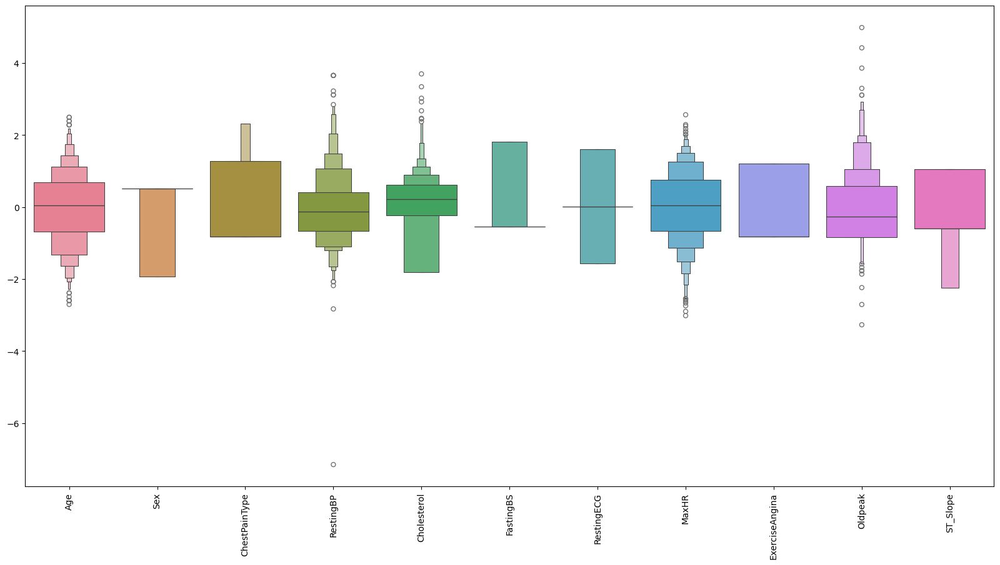

In [60]:
# Prepairing attributes of scale data

features = df.drop(["HeartDisease"], axis=1) # dropping target and extra columns

# Set up a standard scaler for the features
col_names = list(features.columns)
s_scaler = StandardScaler()
features = s_scaler.fit_transform(features)
features = pd.DataFrame(features, columns=col_names) 


plt.figure(figsize=(20,10))
sns.boxenplot(data = features)
plt.xticks(rotation=90)
plt.show()

In [61]:
# Outlier Equation
def outlier_thresholds (dataframe, column, q1=0.25, q3=0.75) :
    quartile1 = dataframe[column].quantile(q1)
    quartile3 = dataframe[column].quantile(q3)
    interquartile_range = quartile3 - quartile1
    up_limit = quartile3 + 1.5 * interquartile_range
    low_limit = quartile1 - 1.5 * interquartile_range
    return low_limit, up_limit

# Checking Outliers
def check_outlier(dataframe, column):
    low_limit, up_limit = outlier_thresholds(dataframe, column)
    outliers = (dataframe[column] > up_limit) | (dataframe[column] < low_limit)
    if outliers.any():
        return True
    else:
        return False

# Replace with threshold
def replace_with_thresholds (dataframe, column) :
    low_limit , up_limit = outlier_thresholds(dataframe, column)
    dataframe.loc[(dataframe[column] < low_limit), column] = low_limit
    dataframe.loc[(dataframe[column] > up_limit), column] = up_limit

# Replace with median
def replace_with_median(dataframe, column):
    low_limit, up_limit = outlier_thresholds(dataframe, column)
    median_value = dataframe[column].mean()
    dataframe.loc[(dataframe[column] < low_limit), column] = median_value
    dataframe.loc[(dataframe[column] > up_limit), column] = median_value

In [62]:
print('Before removing the outliers :')
for column in (df.drop(columns = ["HeartDisease", "Age", "Sex", 'ChestPainType', "FastingBS", "RestingECG", "ExerciseAngina", "ST_Slope"]).columns):
    print(column, check_outlier(df, column))

Before removing the outliers :
RestingBP True
Cholesterol True
MaxHR True
Oldpeak True


In [63]:
print('After removing the outliers :')
for column in (df.drop(columns = ["HeartDisease", "Age", "Sex", 'ChestPainType', "FastingBS", "RestingECG", "ExerciseAngina", "ST_Slope"]).columns):
    replace_with_thresholds(df, column)
    print(column, check_outlier(df, column))

After removing the outliers :
RestingBP False
Cholesterol False
MaxHR False
Oldpeak False


Final check

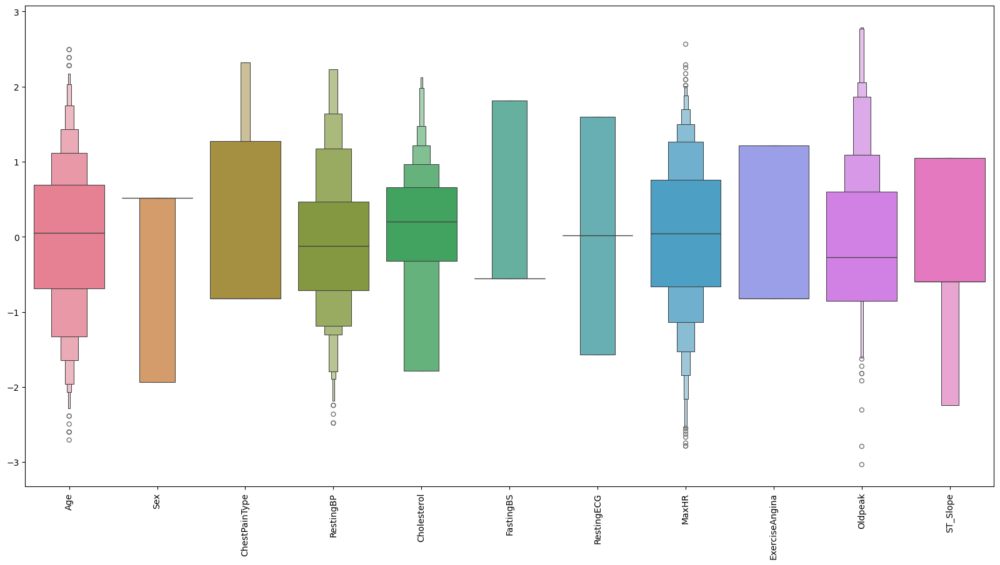

In [64]:
features = df.drop(["HeartDisease"], axis=1) # dropping target and extra columns

# Set up a standard scaler for the features
col_names = list(features.columns)
s_scaler = StandardScaler()
features = s_scaler.fit_transform(features)
features = pd.DataFrame(features, columns=col_names) 

#Detecting outliers

plt.figure(figsize=(20,10))
sns.boxenplot(data = features)
plt.xticks(rotation=90)
plt.show()

Now, we try to explore **Multicollinearity problem**

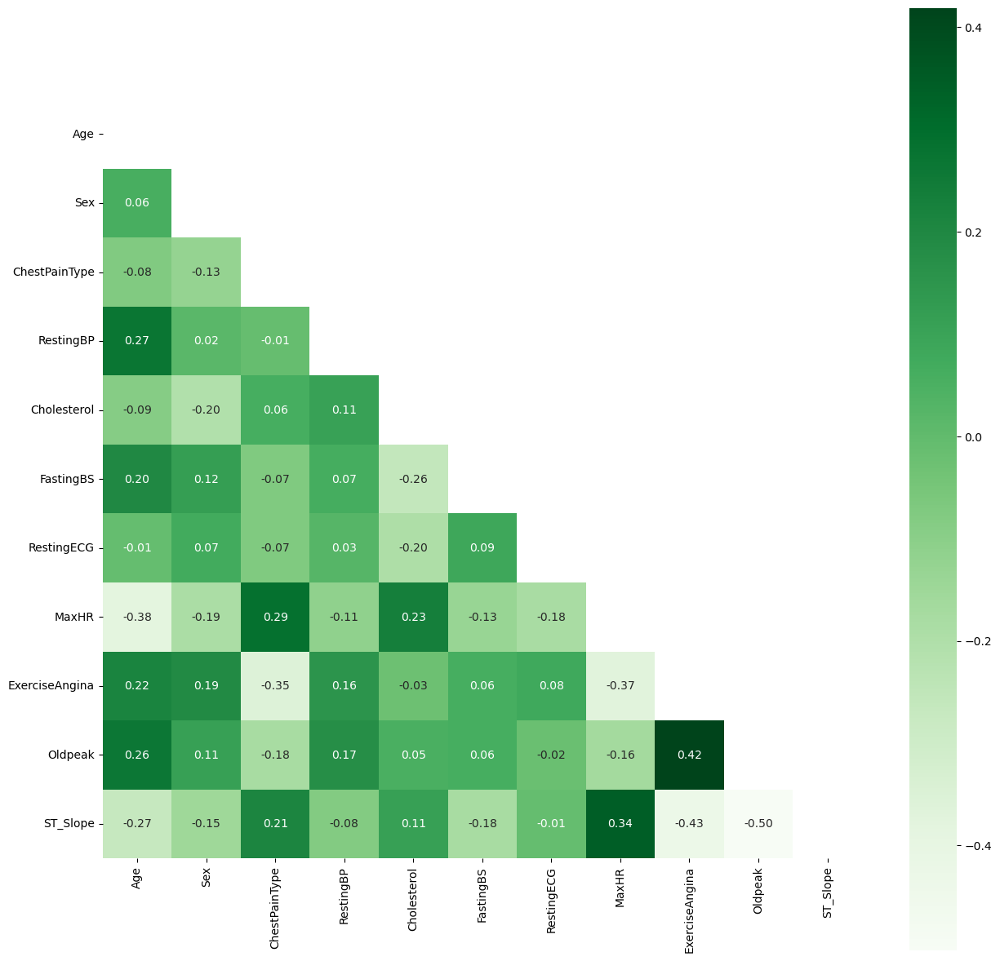

In [65]:
corr = df.drop(["HeartDisease"], axis=1).corr()
mask = np.triu(np.ones_like(corr, dtype=bool))
plt.figure(figsize=(15,15))
ax = sns.heatmap(corr, mask=mask, square=True, annot=True, fmt='.2f', cmap='Greens')
ax.set_xticklabels(ax.get_xticklabels(), rotation=90)
plt.show()

From the matrix we can observe that some features are higly correlated. 

So, we can adopt the **VIF** method or *Variance Inflaction Factor*. In VIF method, we pick each feature and regress it against all of the other features. For each regression, the factor is calculated as :
$$ VIF = \frac{1}{1 - R^2}$$
As we see from the formula, greater the value of $R^2$, greater is the $VIF$. Hence, greater $VIF$ denotes greater correlation.

In [66]:
# add a constant
X = add_constant(df.drop(['HeartDisease'], axis=1))

# for each column we calculate the vif value
vif_data = pd.DataFrame()
vif_data["feature"] = X.columns
vif_data["VIF"] = [variance_inflation_factor(X.values, i) for i in range(X.shape[1])]

print(vif_data)


           feature         VIF
0            const  171.534899
1              Age    1.347299
2              Sex    1.100688
3    ChestPainType    1.197766
4        RestingBP    1.128274
5      Cholesterol    1.219654
6        FastingBS    1.135228
7       RestingECG    1.079697
8            MaxHR    1.512369
9   ExerciseAngina    1.541720
10         Oldpeak    1.519164
11        ST_Slope    1.589384


# Machine Learning
Now we can focus our attention on predicting the target column **RainTomorrow** by using different ML algorithm.

## Data Preprocessing

From the chart we can see that we have the problem of **IMBALACED DATASET**.

This aspect is a problem in the field of Machine Learning because when we try to apply any prediction algorithm we will notice that it will predict the majority class well, but not the minority.

This is because the algorithm was trained on an instance that had a majority of 'NO' cases.

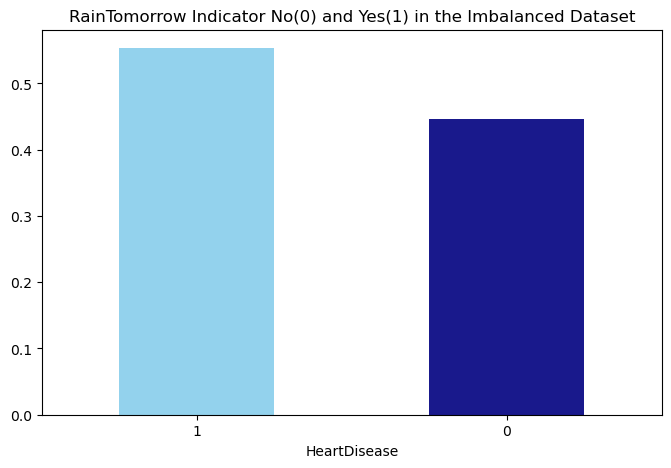

In [67]:
fig = plt.figure(figsize = (8,5))
df.HeartDisease.value_counts(normalize = True).plot(kind='bar', color= ['skyblue','navy'], alpha = 0.9, rot=0)
plt.title('RainTomorrow Indicator No(0) and Yes(1) in the Imbalanced Dataset')
plt.show()

But **BEFORE** trying to use some skills to avoid this problem we have to split the data into train and test set:

### Divide the data into train and test set

In [68]:
X = df.drop('HeartDisease', axis = 1)
y = df['HeartDisease']

X_train, X_test, y_train, y_test = train_test_split(X, y, random_state=42, stratify=df['HeartDisease'])

print('X_train size', X_train.shape)
print('y_train size', y_train.shape)
print('X_test size', X_test.shape)
print('y_test size', y_test.shape)

X_train size (688, 11)
y_train size (688,)
X_test size (230, 11)
y_test size (230,)


### Rebalance the data
Now we can try to apply some skills to avoid imbalanced dataset. We are going to use **SMOTE** and **UNDERSAMPLE** on the train set, not to the test set. If we use SMOTE on the whole dataset before splitting, some synthetic samples will end up in the test set, leading to overly optimistic results.

#### Synthetic Minority Oversampling Technique (SMOTE)
SMOTE is an oversampling technique where the synthetic samples are generated for the minority class. 
- At first, the total number of oversampling observations $N$ is set up. Generally, it is selected such that the binary class distribution is $1:1$.

- Then the iteration starts by first selecting a positive class instance at random.

- Next, the **KNN’s** (by default 5) for that instance is obtained.

-  At last, $N$ of these $K$ instances is chosen to interpolate new synthetic instances. To do that, using any distance metric the difference in distance between the feature vector and its neighbors is calculated. Now, this difference is multiplied by any random value in $(0,1]$ and is added to the previous feature vector.

In [69]:
smote = SMOTE(random_state=42)
X_train_smote, y_train_smote = smote.fit_resample(X_train, y_train)

print("Class Distribution after SMOTE:", y_train_smote.value_counts())

print('X_train size', X_train_smote.shape)
print('y_train size', y_train_smote.shape)
print('X_test size', X_test.shape)
print('y_test size', y_test.shape)

Class Distribution after SMOTE: HeartDisease
0    381
1    381
Name: count, dtype: int64
X_train size (762, 11)
y_train size (762,)
X_test size (230, 11)
y_test size (230,)


#### Undersample
An other way of handling imbalanced datasets is to reduce the number of observations from the majority class to the minority class ones.

The most well known algorithm in this group is random undersampling, where samples from the targeted classes are removed at random.

In [70]:
rus = RandomUnderSampler(random_state=42, sampling_strategy = 'majority')

X_train_under, y_train_under = rus.fit_resample(X_train, y_train)

print("Class Distribution after undersample:", y_train_under.value_counts())

print('X_train size', X_train_under.shape)
print('y_train size', y_train_under.shape)
print('X_test size', X_test.shape)
print('y_test size', y_test.shape)

Class Distribution after undersample: HeartDisease
0    307
1    307
Name: count, dtype: int64
X_train size (614, 11)
y_train size (614,)
X_test size (230, 11)
y_test size (230,)


### Standardize them
By using *StandardScaler* we apply standardization to the three different models, i.e. **no resample datset**, **SMOTE dataset** and **undersample dataset**.

In [71]:
# Standardize the original training set
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

# Standardize the SMOTE training set
scaler_smote = StandardScaler()
X_train_smote_scaled = scaler_smote.fit_transform(X_train_smote)
X_test_smote_scaled = scaler_smote.transform(X_test)

# Standardize the under-sampled training set
scaler_under = StandardScaler()
X_train_under_scaled = scaler_under.fit_transform(X_train_under)
X_test_under_scaled = scaler_under.transform(X_test)

### Model Evaluation Class
This class train and test the selected model and generates the most important metrics:
- **Accuracy**: it calculates the fraction of correct prediction
    $$Accuracy = \frac{TP + TN}{TP + TN + FP + FN}$$
- **Precision**: in words, precision answers the question: "Out of all the instances predicted as positive by the model, how many were actually positive?". It is particularly important in situations where the cost of false positives (instances predicted as positive but are actually negative) is high, and you want to minimize the chances of making false positive predictions.
    $$Precision = \frac{TP}{TP + FP}$$
- **Recall**: in words, recall answers the question: "Out of all the actual positive instances, how many did the model correctly identify?". It is particularly important in situations where the cost of missing positive instances (false negatives) is high, and you want to minimize the chances of false negatives.
    $$Recall = \frac{TP}{TP + FN}$$
- **F1**: the F1 score provides a balance between precision and recall. It ranges from $0$ to $1$, where $1$ indicates perfect precision and recall, and $0$ indicates poor performance
    $$F1 = 2\times\frac{Precision \times Recall}{Precision \times Recall}$$

In [72]:
class Model:
    def __init__(self, model, name = None, scaled = True, resample = None):
        self.model = model
        self.name = name
        self.scaled = scaled
        self.resample = resample
    def fit(self):
        if self.scaled == True and self.resample == None:
            self.model.fit(X_train_scaled, y_train)
        if self.scaled == False and self.resample == None:
            self.model.fit(X_train, y_train)
        if self.scaled == True and self.resample == 'smote':
            self.model.fit(X_train_smote_scaled, y_train_smote)
        if self.scaled == False and self.resample == 'smote':
            self.model.fit(X_train_smote, y_train_smote)
        if self.scaled == True and self.resample == 'under':
            self.model.fit(X_train_under_scaled, y_train_under)
        if self.scaled == False and self.resample == 'under':
            self.model.fit(X_train_under, y_train_under)
    def __get_predictions(self):
        if self.scaled == True and self.resample == None:
            return self.model.predict(X_test_scaled), self.model.predict_proba(X_test_scaled)[:,1]
        if self.scaled == False and self.resample == None:
            return self.model.predict(X_test), self.model.predict_proba(X_test)[:,1]
        if self.scaled == True and self.resample == 'smote':
            return self.model.predict(X_test_smote_scaled), self.model.predict_proba(X_test_smote_scaled)[:,1]
        if self.scaled == False and self.resample == 'smote':
            return self.model.predict(X_test), self.model.predict_proba(X_test)[:,1]
        if self.scaled == True and self.resample == 'under':
            return self.model.predict(X_test_under_scaled), self.model.predict_proba(X_test_under_scaled)[:,1]
        if self.scaled == False and self.resample == 'under':
            return self.model.predict(X_test), self.model.predict_proba(X_test)[:,1]
    def get_metrics(self) -> pd.Series:
        y_pred, y_probs = self.__get_predictions()
        accuracy = metrics.accuracy_score(y_test, y_pred)
        precision = metrics.precision_score(y_test, y_pred)
        recall = metrics.recall_score(y_test, y_pred)
        f1 = metrics.f1_score(y_test, y_pred)
        roc_auc = metrics.roc_auc_score(y_test, y_probs)
        conf_mat = metrics.confusion_matrix(y_test, y_pred)
        pr_auc = metrics.average_precision_score(y_test, y_probs)
        metrics_series = pd.Series({
            'Accuracy': accuracy,
            'Precision': precision,
            'Recall': recall,
            'F1-Score': f1,
            'ROC AUC': roc_auc,
            'Confusion Matrix': conf_mat,
            'PR AUC': pr_auc,
            'Name': self.name
        })
        if self.name == '' or self.name is None:
            metrics_series.Name =type(self.model).__name__
        return metrics_series
    
    def visualize_metrics(self):
        y_pred, y_probs = self.__get_predictions()
        fpr, tpr, thresholds = metrics.roc_curve(y_test, y_probs)
        roc_auc = metrics.roc_auc_score(y_test, y_probs)
        # Calculate Precision-Recall curve and AUC
        precision, recall, _ = metrics.precision_recall_curve(y_test, y_probs)
        pr_auc = metrics.auc(recall, precision)
        # Plot ROC curve
        plt.figure(figsize=(20, 10))
        plt.subplot(2, 2, 1)
        plt.axis('equal')
        plt.plot(fpr, tpr, color='darkorange', lw=2, label=f'ROC curve (AUC = {roc_auc:.2f})')
        plt.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--')
        plt.xlabel('False Positive Rate (FPR)')
        plt.ylabel('True Positive Rate (TPR)')
        plt.title('Receiver Operating Characteristic (ROC) Curve')
        plt.legend(loc='lower right')

        # Plot Precision-Recall curve
        plt.subplot(2, 2, 2)
        plt.plot(recall, precision, color='blue', lw=2, label=f'Precision-Recall curve (AUC = {pr_auc:.2f})')
        plt.xlabel('Recall')
        plt.ylabel('Precision')
        plt.title('Precision-Recall Curve')
        plt.legend(loc='lower left')

        residuals = y_test - y_probs
        # Plot Confusion Matrix and Distribution of errors
        plt.subplot(2, 2, 3)
        conf_mat = metrics.confusion_matrix(y_test, y_pred)
        sns.heatmap(conf_mat, annot=True, fmt='d', cmap='Blues', cbar=False,
                    xticklabels=['Predicted 0', 'Predicted 1'],
                    yticklabels=['Actual 0', 'Actual 1'])
        plt.xlabel('Predicted Label')
        plt.ylabel('True Label')
        plt.title('Confusion Matrix')
        plt.subplot(2, 2, 4)
        sns.histplot(residuals, bins=30, edgecolor='black', kde=True)
        plt.xlabel('Residuals')
        plt.ylabel('Frequency')
        plt.title('Distribution of Errors')
        plt.show()

Here I create 3 different dataframe because for each ML algorithm that I'm going to use, I'm going to save the performance for each approach (No Resample, SMOTE, Undersample).

In [73]:
models_df = pd.DataFrame(columns=['Name',
    'Accuracy',
    'Precision',
    'Recall',
    'F1-Score',
    'ROC AUC',
    'Confusion Matrix',
    'PR AUC'])

models_df_smote = pd.DataFrame(columns=['Name',
    'Accuracy',
    'Precision',
    'Recall',
    'F1-Score',
    'ROC AUC',
    'Confusion Matrix',
    'PR AUC'])

models_df_under = pd.DataFrame(columns=['Name',
    'Accuracy',
    'Precision',
    'Recall',
    'F1-Score',
    'ROC AUC',
    'Confusion Matrix',
    'PR AUC'])

## Linear Discriminant Analysis (LDA)
A classifier with a linear decision boundary, generated by fitting class conditional densities to the data and using Bayes’ rule. In particular, the model fits a Gaussian density to each class, assuming that all classes share the same covariance matrix.

### No resample

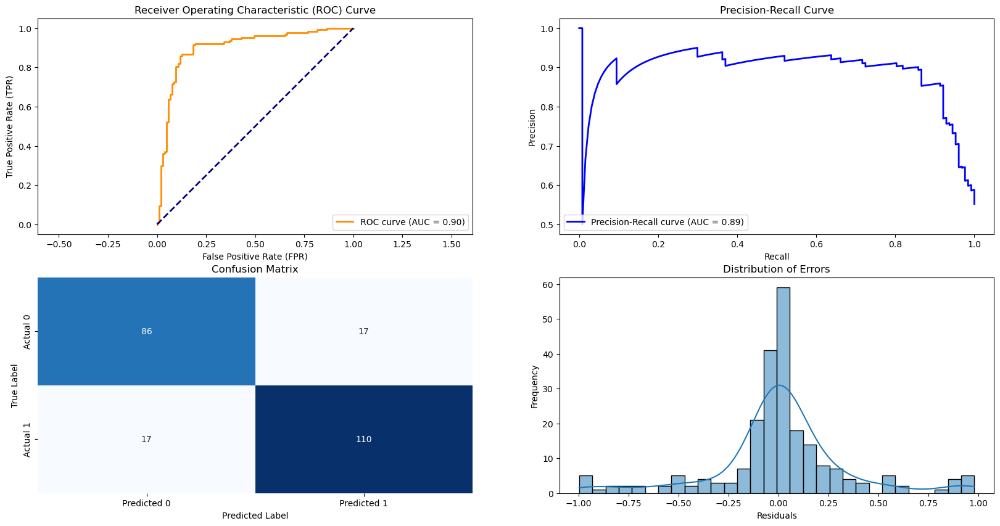

In [74]:
model = Model(LinearDiscriminantAnalysis(), name='LDA No Resample', scaled=True, resample=None)
model.fit()
model.visualize_metrics()

In [75]:
metrics_LDA_no_resample = model.get_metrics()
models_df = pd.concat([models_df, metrics_LDA_no_resample.to_frame().T])
print(metrics_LDA_no_resample)

Accuracy                         0.852174
Precision                        0.866142
Recall                           0.866142
F1-Score                         0.866142
ROC AUC                          0.901766
Confusion Matrix    [[86, 17], [17, 110]]
PR AUC                           0.890998
Name                      LDA No Resample
dtype: object


### SMOTE

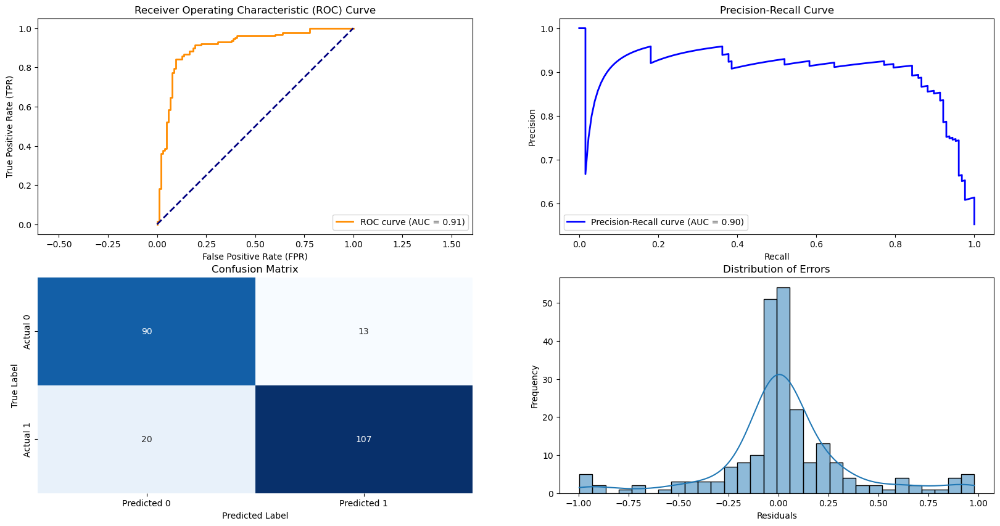

In [76]:
model = Model(LinearDiscriminantAnalysis(), name='LDA SMOTE', scaled=True, resample='smote')
model.fit()
model.visualize_metrics()

In [77]:
metrics_LDA_smote = model.get_metrics()
models_df_smote = pd.concat([models_df_smote, metrics_LDA_smote.to_frame().T])
print(metrics_LDA_smote)

Accuracy                         0.856522
Precision                        0.891667
Recall                            0.84252
F1-Score                         0.866397
ROC AUC                          0.906888
Confusion Matrix    [[90, 13], [20, 107]]
PR AUC                           0.901241
Name                            LDA SMOTE
dtype: object


### Undersample

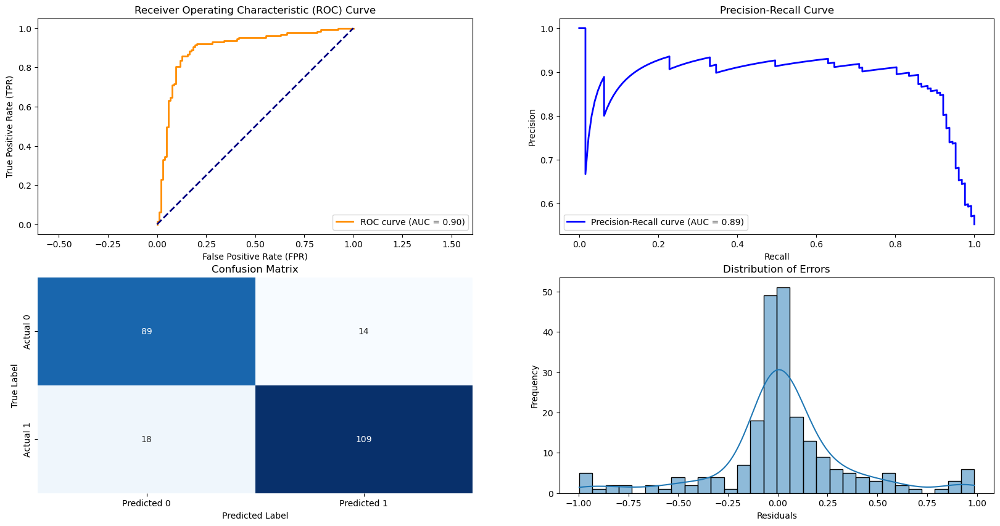

In [78]:
model = Model(LinearDiscriminantAnalysis(), name='LDA undersample', scaled=True, resample='under')
model.fit()
model.visualize_metrics()

In [79]:
metrics_LDA_under = model.get_metrics()
models_df_under = pd.concat([models_df_under, metrics_LDA_under.to_frame().T])
print(metrics_LDA_under)

Accuracy                          0.86087
Precision                        0.886179
Recall                           0.858268
F1-Score                            0.872
ROC AUC                          0.898555
Confusion Matrix    [[89, 14], [18, 109]]
PR AUC                           0.887331
Name                      LDA undersample
dtype: object


## Logistic Regression
It is a special case of linear regression where the target variable is categorical in nature. Logistic Regression predicts the probability of occurrence of a binary event utilizing the Sigmoid Function.

### No resample
In this case we perform *GridSearchCV* in order to establish the parameters of the model that performs better.

In [80]:
param_grid = {
    'C': [0.001, 0.01, 0.1, 1, 10, 100],  # Regularization strength
    'penalty': ['l2'],  # Regularization penalty
    'solver': ['liblinear', 'lbfgs','newton-cg','newton-cholesky','sag','saga']  # Optimization algorithm
}
clf = GridSearchCV(LogisticRegression(), param_grid)
clf = clf.fit(X_train_scaled, y_train)
best_lr_model = clf.best_estimator_

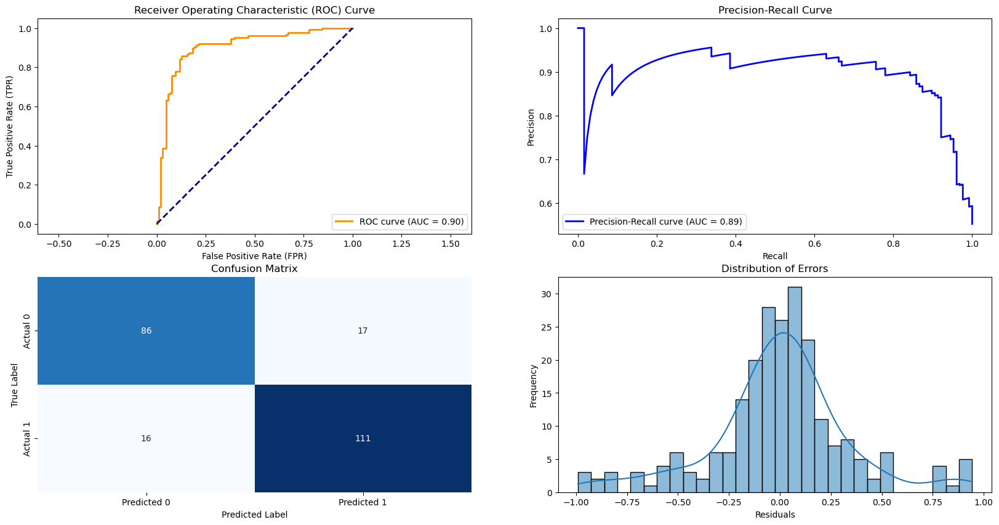

In [81]:
# Create the model
model = Model(best_lr_model, 
              name='Logistic Regression No Resample', 
              scaled=True, resample=None)
model.fit()
model.visualize_metrics()

In [82]:
metrics_LR_no_resample = model.get_metrics()
models_df = pd.concat([models_df, metrics_LR_no_resample.to_frame().T])
print(metrics_LR_no_resample)

Accuracy                                   0.856522
Precision                                  0.867188
Recall                                     0.874016
F1-Score                                   0.870588
ROC AUC                                    0.903677
Confusion Matrix              [[86, 17], [16, 111]]
PR AUC                                     0.896051
Name                Logistic Regression No Resample
dtype: object


### SMOTE

In [83]:
param_grid = {
    'C': [0.001, 0.01, 0.1, 1, 10, 100],  # Regularization strength
    'penalty': ['l2'],  # Regularization penalty
    'solver': ['liblinear', 'lbfgs','newton-cg','newton-cholesky','sag','saga']  # Optimization algorithm
}
clf = GridSearchCV(LogisticRegression(), param_grid)
clf = clf.fit(X_train_smote_scaled, y_train_smote)
best_lr_model = clf.best_estimator_

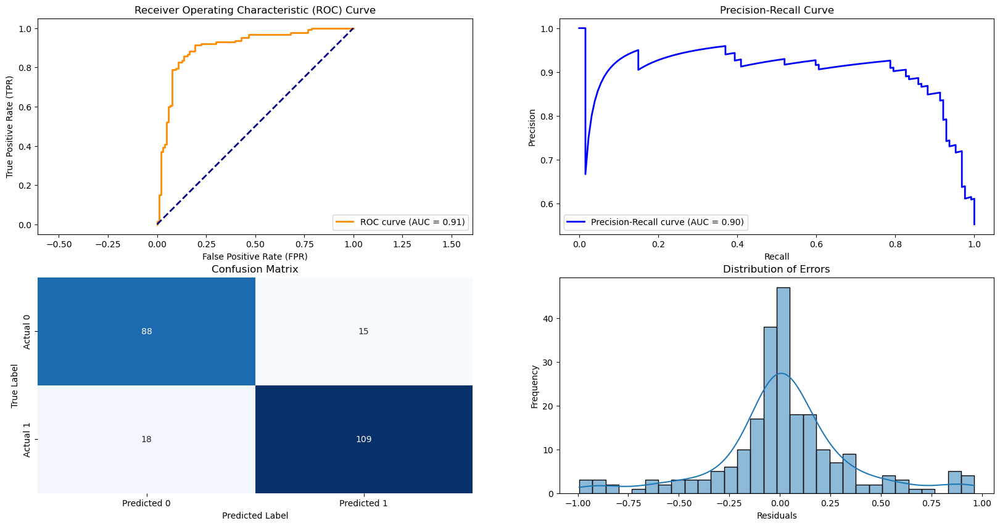

In [84]:
model = Model(best_lr_model, 
              name='Logistic Regression Smote', 
              scaled=True, resample='smote')
model.fit()
model.visualize_metrics()

In [85]:
metrics_LR_smote = model.get_metrics()
models_df_smote = pd.concat([models_df_smote, metrics_LR_smote.to_frame().T])
print(metrics_LR_smote)

Accuracy                             0.856522
Precision                            0.879032
Recall                               0.858268
F1-Score                             0.868526
ROC AUC                              0.905359
Confusion Matrix        [[88, 15], [18, 109]]
PR AUC                               0.899471
Name                Logistic Regression Smote
dtype: object


### Undersample

In [86]:
param_grid = {
    'C': [0.001, 0.01, 0.1, 1, 10, 100],  # Regularization strength
    'penalty': ['l2'],  # Regularization penalty
    'solver': ['liblinear', 'lbfgs','newton-cg','newton-cholesky','sag','saga']  # Optimization algorithm
}
clf = GridSearchCV(LogisticRegression(), param_grid)
clf = clf.fit(X_train_under_scaled, y_train_under)
best_lr_model = clf.best_estimator_

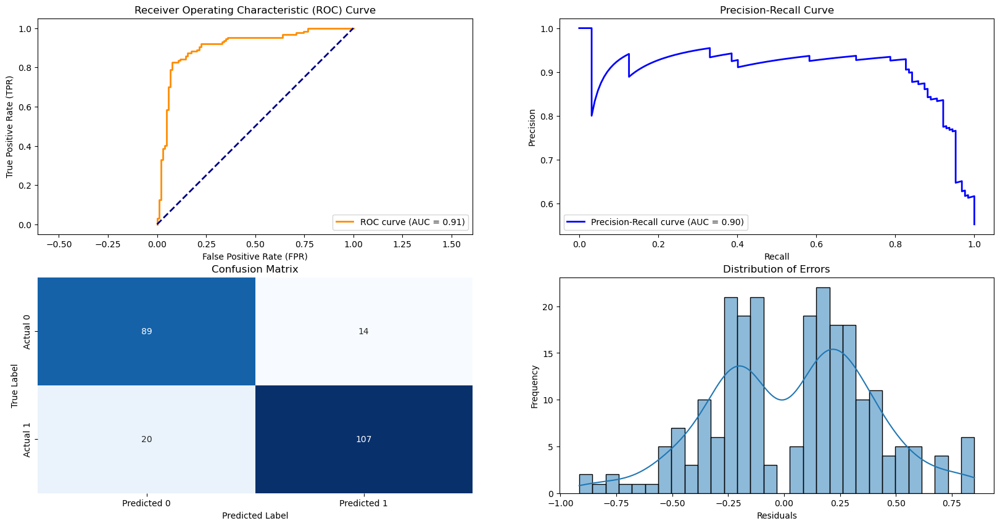

In [87]:
model = Model(best_lr_model, 
              name='Logistic Regression Undersample', 
              scaled=True, resample='under')
model.fit()
model.visualize_metrics()

In [88]:
metrics_LR_under = model.get_metrics()
models_df_under = pd.concat([models_df_under, metrics_LR_under.to_frame().T])
print(metrics_LR_under)

Accuracy                                   0.852174
Precision                                  0.884298
Recall                                      0.84252
F1-Score                                   0.862903
ROC AUC                                    0.907423
Confusion Matrix              [[89, 14], [20, 107]]
PR AUC                                     0.904637
Name                Logistic Regression Undersample
dtype: object


## Decision Tree Classifier
In this case, but also in others, I preferred to use *RandomizedSearchCV*. Its concept is the same of *GridSearchCV*, but it is faster. In fact, in contrast to GridSearchCV, not all parameter values are tried out, but rather a fixed number of parameter settings is sampled from the specified distributions.

### No Resample

In [89]:
from scipy.stats import randint

param_dist = {
    'max_depth': randint(1, 20),
    'min_samples_split': randint(2, 40),
    'min_samples_leaf': randint(1, 20),
    'criterion': ['gini', 'entropy'],
    'max_features': ['sqrt', 'log2', None]
}

dt = DecisionTreeClassifier(random_state=42)

random_search = RandomizedSearchCV(dt, param_distributions=param_dist, 
                                   n_iter=100, cv=5, verbose=2, random_state=42, n_jobs=-1)


random_search.fit(X_train_scaled, y_train)
best_dt_model = random_search.best_estimator_

Fitting 5 folds for each of 100 candidates, totalling 500 fits
[CV] END criterion=gini, max_depth=19, max_features=None, min_samples_leaf=11, min_samples_split=12; total time=   0.0s
[CV] END criterion=gini, max_depth=15, max_features=None, min_samples_leaf=8, min_samples_split=22; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, max_features=log2, min_samples_leaf=1, min_samples_split=13; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, max_features=log2, min_samples_leaf=1, min_samples_split=13; total time=   0.0s
[CV] END criterion=gini, max_depth=15, max_features=None, min_samples_leaf=8, min_samples_split=22; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, max_features=log2, min_samples_leaf=1, min_samples_split=13; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, max_features=log2, min_samples_leaf=1, min_samples_split=13; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, max_features=sqrt, min_samples_leaf=17, min_samples_s

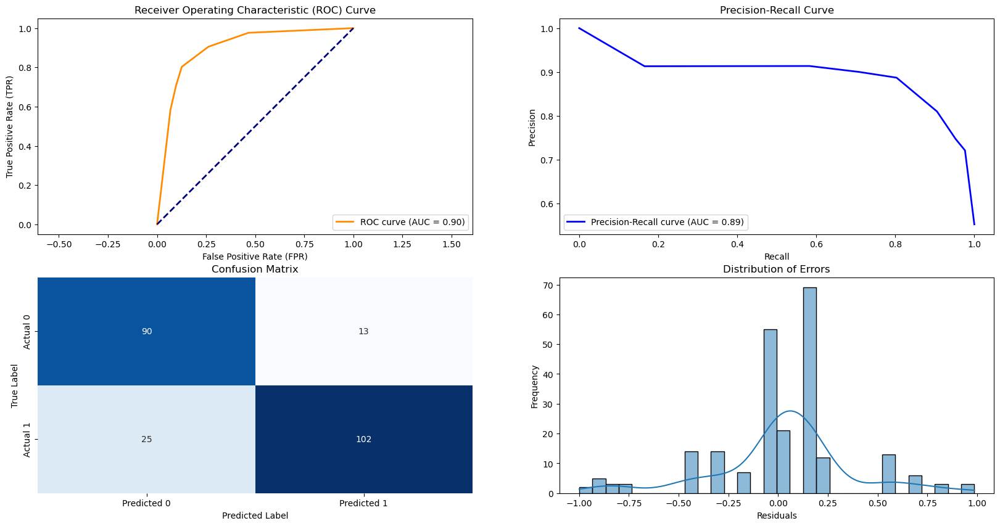

In [90]:
model = Model(best_dt_model, 
              name='DT No Resample', 
              scaled=True, resample=None)
model.fit()
model.visualize_metrics()

In [91]:
metrics_DT_no_resample = model.get_metrics()
models_df = pd.concat([models_df, metrics_DT_no_resample.to_frame().T])
print(metrics_DT_no_resample)

Accuracy                         0.834783
Precision                        0.886957
Recall                            0.80315
F1-Score                         0.842975
ROC AUC                          0.896224
Confusion Matrix    [[90, 13], [25, 102]]
PR AUC                           0.877686
Name                       DT No Resample
dtype: object


### SMOTE

In [92]:
param_dist = {
    'max_depth': randint(1, 20),
    'min_samples_split': randint(2, 40),
    'min_samples_leaf': randint(1, 20),
    'criterion': ['gini', 'entropy'],
    'max_features': ['sqrt', 'log2', None]
}

dt = DecisionTreeClassifier(random_state=42)

random_search = RandomizedSearchCV(dt, param_distributions=param_dist, 
                                   n_iter=100, cv=5, verbose=2, random_state=42, n_jobs=-1)


random_search.fit(X_train_smote_scaled, y_train_smote)
best_dt_model = random_search.best_estimator_

Fitting 5 folds for each of 100 candidates, totalling 500 fits
[CV] END criterion=gini, max_depth=15, max_features=None, min_samples_leaf=8, min_samples_split=22; total time=   0.0s
[CV] END criterion=gini, max_depth=15, max_features=None, min_samples_leaf=8, min_samples_split=22; total time=   0.0s
[CV] END criterion=gini, max_depth=15, max_features=None, min_samples_leaf=8, min_samples_split=22; total time=   0.0s
[CV] END criterion=gini, max_depth=15, max_features=None, min_samples_leaf=8, min_samples_split=22; total time=   0.0s
[CV] END criterion=gini, max_depth=15, max_features=None, min_samples_leaf=8, min_samples_split=22; total time=   0.0s
[CV] END criterion=gini, max_depth=19, max_features=None, min_samples_leaf=11, min_samples_split=12; total time=   0.0s
[CV] END criterion=gini, max_depth=19, max_features=None, min_samples_leaf=11, min_samples_split=12; total time=   0.0s
[CV] END criterion=gini, max_depth=19, max_features=None, min_samples_leaf=11, min_samples_split=12; t

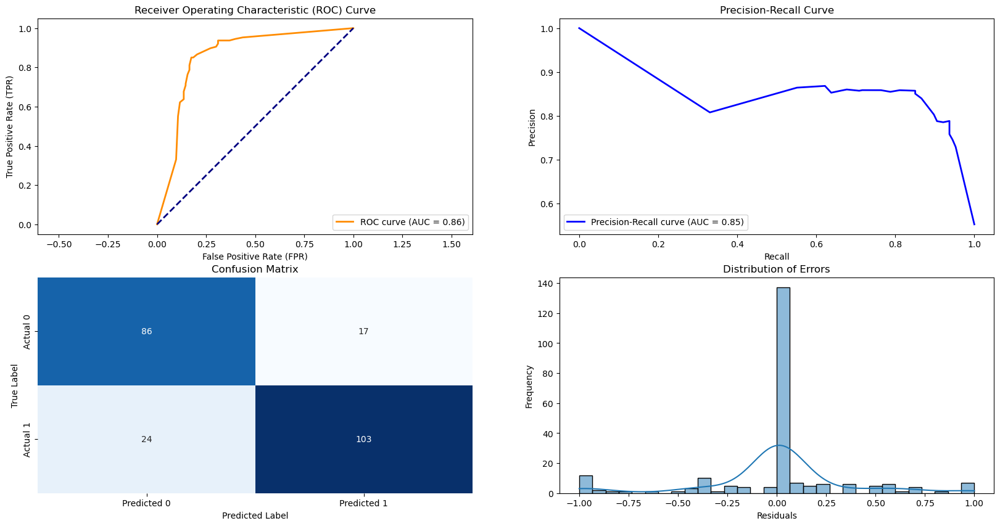

In [93]:
model = Model(best_dt_model, 'DT Smote', scaled=True, resample='smote')
model.fit()
model.visualize_metrics()

In [94]:
metrics_DT_smote = model.get_metrics()
models_df_smote = pd.concat([models_df_smote, metrics_DT_smote.to_frame().T])
print(metrics_DT_smote)

Accuracy                         0.821739
Precision                        0.858333
Recall                           0.811024
F1-Score                         0.834008
ROC AUC                          0.856395
Confusion Matrix    [[86, 17], [24, 103]]
PR AUC                           0.822087
Name                             DT Smote
dtype: object


### Undersample

In [95]:
param_dist = {
    'max_depth': randint(1, 20),
    'min_samples_split': randint(2, 40),
    'min_samples_leaf': randint(1, 20),
    'criterion': ['gini', 'entropy'],
    'max_features': ['sqrt', 'log2', None]
}

dt = DecisionTreeClassifier(random_state=42)

random_search = RandomizedSearchCV(dt, param_distributions=param_dist, 
                                   n_iter=100, cv=5, verbose=2, random_state=42, n_jobs=-1)


random_search.fit(X_train_under_scaled, y_train_under)
best_dt_model = random_search.best_estimator_

Fitting 5 folds for each of 100 candidates, totalling 500 fits
[CV] END criterion=gini, max_depth=15, max_features=None, min_samples_leaf=8, min_samples_split=22; total time=   0.0s
[CV] END criterion=gini, max_depth=15, max_features=None, min_samples_leaf=8, min_samples_split=22; total time=   0.0s
[CV] END criterion=gini, max_depth=15, max_features=None, min_samples_leaf=8, min_samples_split=22; total time=   0.0s
[CV] END criterion=gini, max_depth=15, max_features=None, min_samples_leaf=8, min_samples_split=22; total time=   0.0s
[CV] END criterion=gini, max_depth=15, max_features=None, min_samples_leaf=8, min_samples_split=22; total time=   0.0s
[CV] END criterion=gini, max_depth=19, max_features=None, min_samples_leaf=11, min_samples_split=12; total time=   0.0s
[CV] END criterion=gini, max_depth=19, max_features=None, min_samples_leaf=11, min_samples_split=12; total time=   0.0s
[CV] END criterion=gini, max_depth=19, max_features=None, min_samples_leaf=11, min_samples_split=12; t

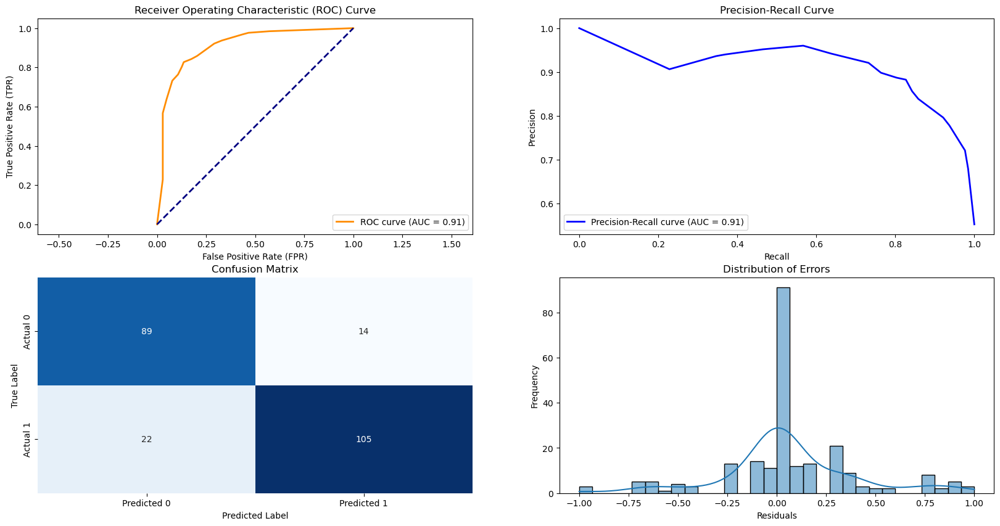

In [96]:
model = Model(best_dt_model, name='DT Undersample', scaled=False, resample='under')
model.fit()
model.visualize_metrics()

In [97]:
metrics_DT_under = model.get_metrics()
models_df_under = pd.concat([models_df_under, metrics_DT_under.to_frame().T])
print(metrics_DT_under)

Accuracy                         0.843478
Precision                        0.882353
Recall                           0.826772
F1-Score                         0.853659
ROC AUC                          0.909487
Confusion Matrix    [[89, 14], [22, 105]]
PR AUC                            0.89755
Name                       DT Undersample
dtype: object


## Random Forest
A random forest is a meta estimator that fits a number of decision tree classifiers on various sub-samples of the dataset and uses averaging to improve the predictive accuracy and control over-fitting. 

### No Resample

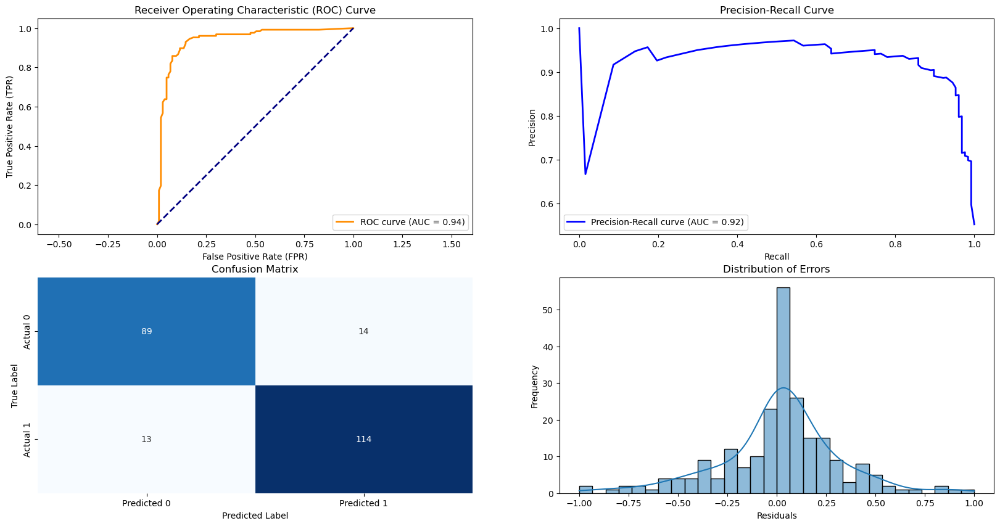

In [98]:
model = Model(RandomForestClassifier(), name='RF No Resample', scaled=True, resample=None)
model.fit()
model.visualize_metrics()

In [99]:
metrics_RF_no_resample = model.get_metrics()
models_df = pd.concat([models_df, metrics_RF_no_resample.to_frame().T])
print(metrics_RF_no_resample)

Accuracy                         0.882609
Precision                        0.890625
Recall                           0.897638
F1-Score                         0.894118
ROC AUC                          0.939951
Confusion Matrix    [[89, 14], [13, 114]]
PR AUC                           0.928323
Name                       RF No Resample
dtype: object


### SMOTE

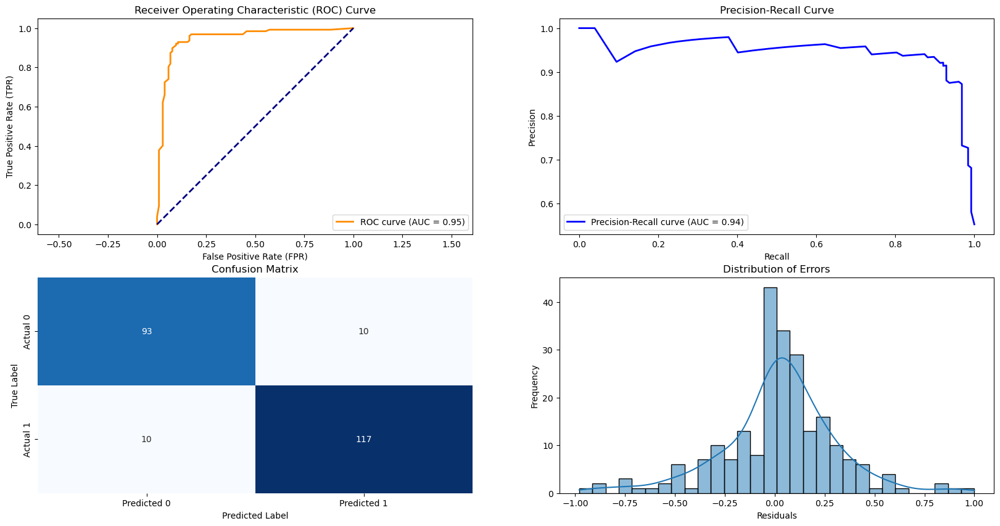

In [100]:
model = Model(RandomForestClassifier(), name='RF SMOTE', scaled=True, resample='smote')
model.fit()
model.visualize_metrics()

In [101]:
metrics_RF_smote = model.get_metrics()
models_df_smote = pd.concat([models_df_smote, metrics_RF_smote.to_frame().T])
print(metrics_RF_smote)

Accuracy                         0.913043
Precision                         0.92126
Recall                            0.92126
F1-Score                          0.92126
ROC AUC                          0.946984
Confusion Matrix    [[93, 10], [10, 117]]
PR AUC                            0.94297
Name                             RF SMOTE
dtype: object


### Undersample

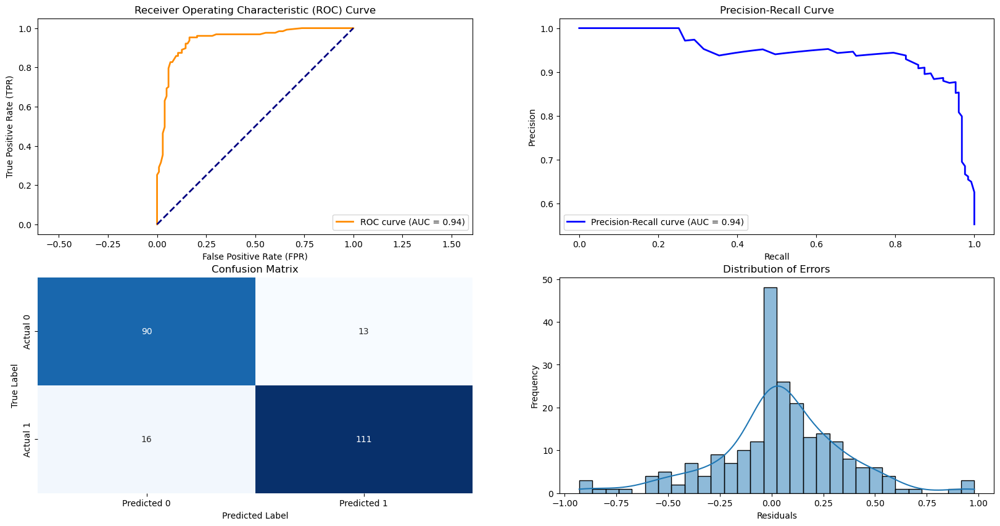

In [102]:
model = Model(RandomForestClassifier(), name='RF Undersample', scaled=True, resample='under')
model.fit()
model.visualize_metrics()

In [103]:
metrics_RF_under = model.get_metrics()
models_df_under = pd.concat([models_df_under, metrics_RF_under.to_frame().T])
print(metrics_RF_under)

Accuracy                         0.873913
Precision                        0.895161
Recall                           0.874016
F1-Score                         0.884462
ROC AUC                          0.938422
Confusion Matrix    [[90, 13], [16, 111]]
PR AUC                           0.942238
Name                       RF Undersample
dtype: object


## KNN
The K-Nearest Neighbors (K-NN) algorithm is a simple and intuitive supervised machine learning method used for both classification and regression tasks. It operates based on the principle that similar data points tend to share common characteristics and are often found close to each other in the feature space.

### No Resample

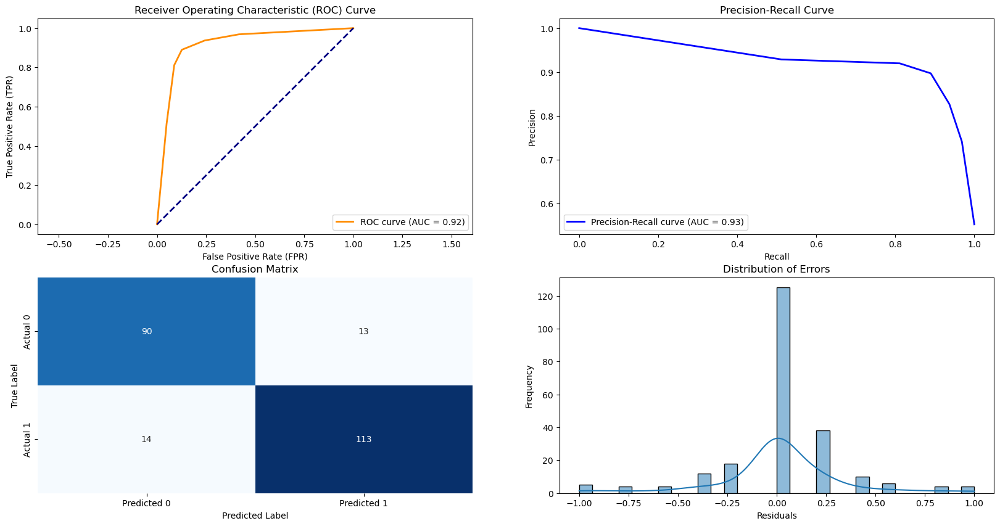

In [104]:
model = Model(KNeighborsClassifier(),'KNN No Resample', scaled=True, resample = None)
model.fit()
model.visualize_metrics()

In [105]:
metrics_KNN_no_resample = model.get_metrics()
models_df = pd.concat([models_df, metrics_KNN_no_resample.to_frame().T])
print(metrics_KNN_no_resample)

Accuracy                         0.882609
Precision                        0.896825
Recall                           0.889764
F1-Score                         0.893281
ROC AUC                          0.917399
Confusion Matrix    [[90, 13], [14, 113]]
PR AUC                           0.900809
Name                      KNN No Resample
dtype: object


### SMOTE

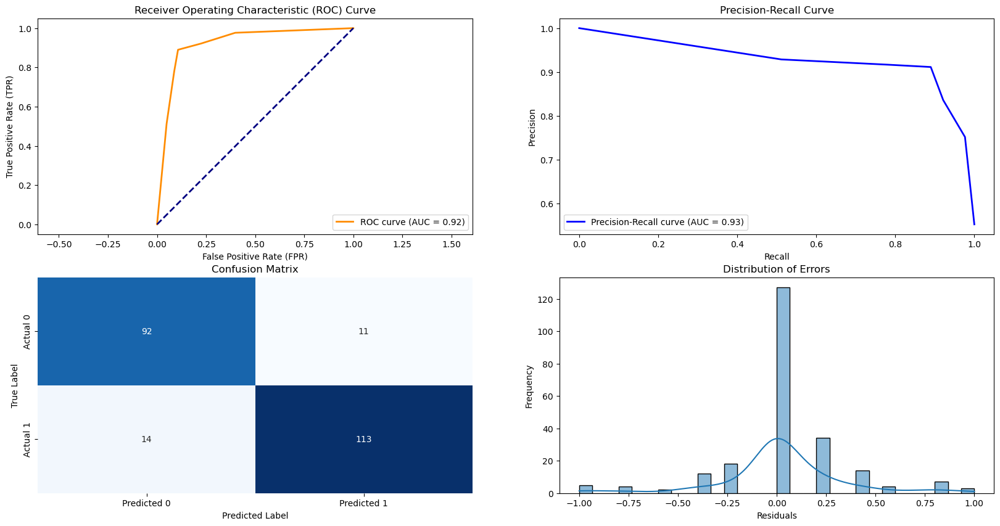

In [106]:
model = Model(KNeighborsClassifier(),'KNN SMOTE', scaled=True, resample = 'smote')
model.fit()
model.visualize_metrics()

In [107]:
metrics_KNN_smote = model.get_metrics()
models_df_smote = pd.concat([models_df_smote, metrics_KNN_smote.to_frame().T])
print(metrics_KNN_smote)

Accuracy                         0.891304
Precision                         0.91129
Recall                           0.889764
F1-Score                         0.900398
ROC AUC                          0.919846
Confusion Matrix    [[92, 11], [14, 113]]
PR AUC                           0.901904
Name                            KNN SMOTE
dtype: object


### Undersample

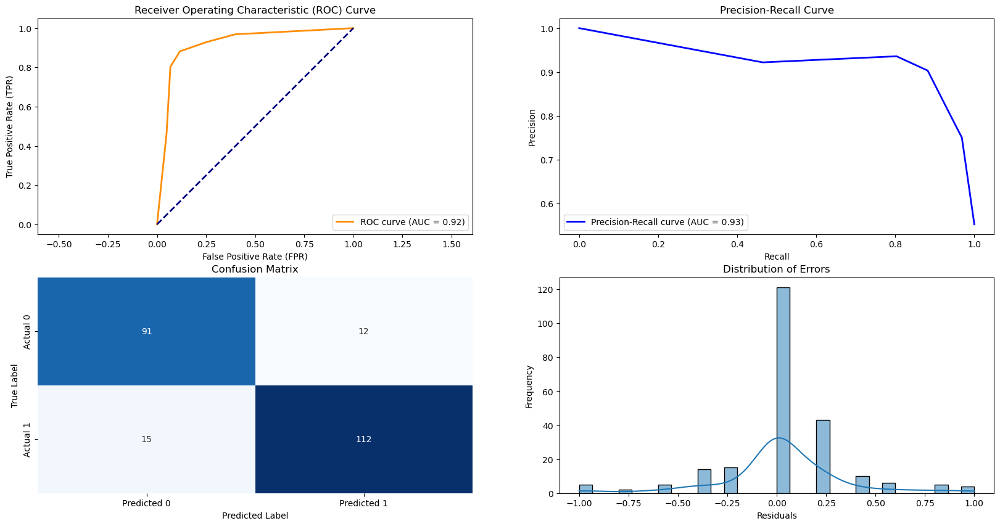

In [108]:
model = Model(KNeighborsClassifier(),'KNN Undersample', scaled=True, resample = 'under')
model.fit()
model.visualize_metrics()

In [109]:
metrics_KNN_under = model.get_metrics()
models_df_under = pd.concat([models_df_under, metrics_KNN_under.to_frame().T])
print(metrics_KNN_under)

Accuracy                         0.882609
Precision                        0.903226
Recall                            0.88189
F1-Score                          0.89243
ROC AUC                          0.918202
Confusion Matrix    [[91, 12], [15, 112]]
PR AUC                           0.901864
Name                      KNN Undersample
dtype: object


## Gradient Boosting Classifier
Gradient Boosting is an ensemble learning technique that combines the predictions of multiple weak learners (typically decision trees) to create a strong predictive model. The Gradient Boosting Classifier, specifically, is used for classification tasks.

Here's a brief description of the Gradient Boosting Classifier:
- **Base Learners (Weak Models)**: The algorithm starts with an initial weak learner, often a shallow decision tree. The model initially makes predictions, and the errors or residuals (the differences between predicted and actual values) are identified.

- **Gradient Descent Optimization**: In subsequent iterations, new weak learners are added to the ensemble, and they focus on correcting the errors made by the existing ensemble. The optimization process is akin to descending a gradient in the error space, hence the name "gradient boosting."

- **Weighted Contributions**: Each weak learner contributes to the final prediction with a certain weight. The weights are determined during the training process, and they depend on the contribution of each learner in minimizing the overall prediction error.

- **Shrinkage (Learning Rate)**: A hyperparameter called the learning rate controls the contribution of each weak learner. A smaller learning rate requires more weak learners but often leads to better generalization.

- **Regularization**: Gradient Boosting includes regularization techniques to prevent overfitting. This may involve constraining the complexity of the individual weak learners or introducing penalties for large weights.

- **Prediction**: The final prediction is made by aggregating the predictions of all weak learners, and the class with the majority of votes is selected as the predicted class for classification tasks.

### No Resample

In [110]:
from scipy.stats import uniform

param_dist = {
    'n_estimators': [500, 800, 1000],
    'learning_rate': uniform(0.01, 0.3),  
    'max_depth': [3, 5, 7],
    'min_samples_split': [10, 20, 40],
    'min_samples_leaf': [20, 50, 70],
    'max_features': ['sqrt', 'log2']
}

gb = GradientBoostingClassifier(random_state=42)

random_search = RandomizedSearchCV(gb, param_distributions=param_dist, 
                                   n_iter=10, cv=3, verbose=2, random_state=42, n_jobs=-1)

random_search.fit(X_train_scaled, y_train)
best_gb_model = random_search.best_estimator_

Fitting 3 folds for each of 10 candidates, totalling 30 fits
[CV] END learning_rate=0.12236203565420874, max_depth=3, max_features=sqrt, min_samples_leaf=70, min_samples_split=10, n_estimators=500; total time=   0.9s
[CV] END learning_rate=0.12236203565420874, max_depth=3, max_features=sqrt, min_samples_leaf=70, min_samples_split=10, n_estimators=500; total time=   0.9s
[CV] END learning_rate=0.12236203565420874, max_depth=3, max_features=sqrt, min_samples_leaf=70, min_samples_split=10, n_estimators=500; total time=   0.9s
[CV] END learning_rate=0.05680559213273095, max_depth=7, max_features=sqrt, min_samples_leaf=70, min_samples_split=40, n_estimators=500; total time=   0.9s
[CV] END learning_rate=0.07370173320348283, max_depth=3, max_features=sqrt, min_samples_leaf=50, min_samples_split=20, n_estimators=500; total time=   0.9s
[CV] END learning_rate=0.05680559213273095, max_depth=7, max_features=sqrt, min_samples_leaf=70, min_samples_split=40, n_estimators=500; total time=   1.0s
[CV

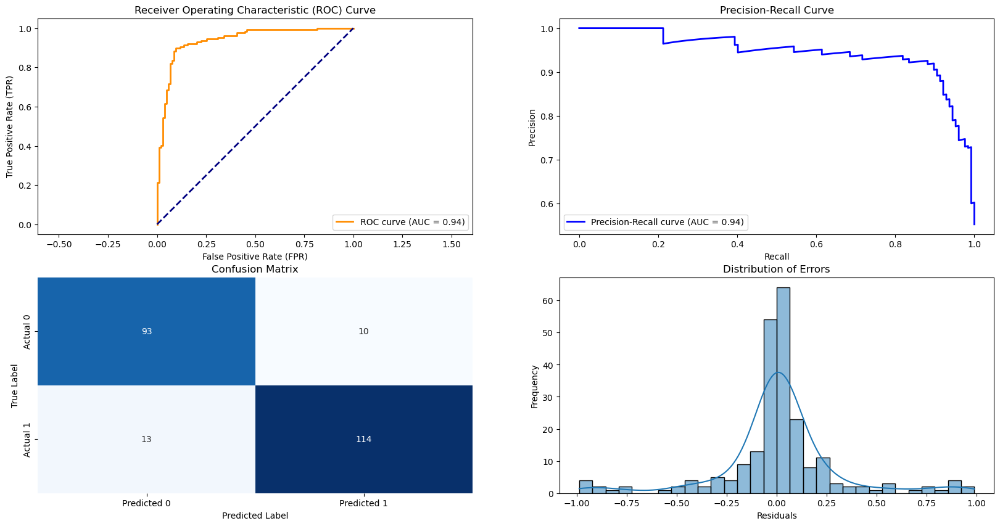

In [111]:
model = Model(best_gb_model, name='Gradient Boosting No Resample', scaled=True, resample=None)
model.fit()
model.visualize_metrics()

In [112]:
metrics_GBC_no_resample = model.get_metrics()
models_df = pd.concat([models_df, metrics_GBC_no_resample.to_frame().T])
print(metrics_GBC_no_resample)

Accuracy                                      0.9
Precision                                0.919355
Recall                                   0.897638
F1-Score                                 0.908367
ROC AUC                                   0.93846
Confusion Matrix            [[93, 10], [13, 114]]
PR AUC                                   0.944652
Name                Gradient Boosting No Resample
dtype: object


### SMOTE

In [113]:

param_dist = {
    'n_estimators': [500, 800, 1000],
    'learning_rate': uniform(0.01, 0.3),  
    'max_depth': [3, 5, 7],
    'min_samples_split': [10, 20, 40],
    'min_samples_leaf': [20, 50, 70],
    'max_features': ['sqrt', 'log2']
}

gb = GradientBoostingClassifier(random_state=42)

random_search = RandomizedSearchCV(gb, param_distributions=param_dist, 
                                   n_iter=10, cv=3, verbose=2, random_state=42, n_jobs=-1)

random_search.fit(X_train_smote_scaled, y_train_smote)
best_gb_model = random_search.best_estimator_

Fitting 3 folds for each of 10 candidates, totalling 30 fits
[CV] END learning_rate=0.07370173320348283, max_depth=3, max_features=sqrt, min_samples_leaf=50, min_samples_split=20, n_estimators=500; total time=   0.9s
[CV] END learning_rate=0.05680559213273095, max_depth=7, max_features=sqrt, min_samples_leaf=70, min_samples_split=40, n_estimators=500; total time=   1.0s
[CV] END learning_rate=0.12236203565420874, max_depth=3, max_features=sqrt, min_samples_leaf=70, min_samples_split=10, n_estimators=500; total time=   1.0s
[CV] END learning_rate=0.07370173320348283, max_depth=3, max_features=sqrt, min_samples_leaf=50, min_samples_split=20, n_estimators=500; total time=   1.0s
[CV] END learning_rate=0.12236203565420874, max_depth=3, max_features=sqrt, min_samples_leaf=70, min_samples_split=10, n_estimators=500; total time=   1.1s
[CV] END learning_rate=0.05680559213273095, max_depth=7, max_features=sqrt, min_samples_leaf=70, min_samples_split=40, n_estimators=500; total time=   1.1s
[CV

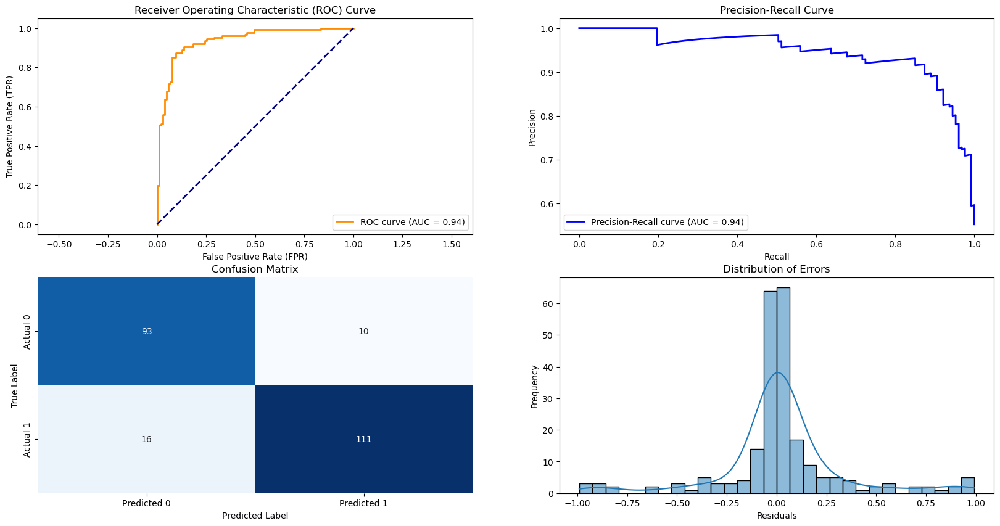

In [114]:
model = Model(best_gb_model, name='Gradient Boosting SMOTE', scaled=True, resample='smote')
model.fit()
model.visualize_metrics()

In [115]:
metrics_GBC_smote = model.get_metrics()
models_df_smote = pd.concat([models_df_smote, metrics_GBC_smote.to_frame().T])
print(metrics_GBC_smote)

Accuracy                           0.886957
Precision                          0.917355
Recall                             0.874016
F1-Score                           0.895161
ROC AUC                            0.936396
Confusion Matrix      [[93, 10], [16, 111]]
PR AUC                              0.94519
Name                Gradient Boosting SMOTE
dtype: object


### Undersample

In [116]:

param_dist = {
    'n_estimators': [500, 800, 1000],
    'learning_rate': uniform(0.01, 0.3),  
    'max_depth': [3, 5, 7],
    'min_samples_split': [10, 20, 40],
    'min_samples_leaf': [20, 50, 70],
    'max_features': ['sqrt', 'log2']
}

gb = GradientBoostingClassifier(random_state=42)

random_search = RandomizedSearchCV(gb, param_distributions=param_dist, 
                                   n_iter=10, cv=3, verbose=2, random_state=42, n_jobs=-1)

random_search.fit(X_train_under_scaled, y_train_under)
best_gb_model = random_search.best_estimator_

Fitting 3 folds for each of 10 candidates, totalling 30 fits
[CV] END learning_rate=0.12236203565420874, max_depth=3, max_features=sqrt, min_samples_leaf=70, min_samples_split=10, n_estimators=500; total time=   0.9s
[CV] END learning_rate=0.05680559213273095, max_depth=7, max_features=sqrt, min_samples_leaf=70, min_samples_split=40, n_estimators=500; total time=   0.9s
[CV] END learning_rate=0.05680559213273095, max_depth=7, max_features=sqrt, min_samples_leaf=70, min_samples_split=40, n_estimators=500; total time=   0.9s
[CV] END learning_rate=0.07370173320348283, max_depth=3, max_features=sqrt, min_samples_leaf=50, min_samples_split=20, n_estimators=500; total time=   1.0s
[CV] END learning_rate=0.07370173320348283, max_depth=3, max_features=sqrt, min_samples_leaf=50, min_samples_split=20, n_estimators=500; total time=   1.0s
[CV] END learning_rate=0.12236203565420874, max_depth=3, max_features=sqrt, min_samples_leaf=70, min_samples_split=10, n_estimators=500; total time=   1.0s
[CV

/home/tony/anaconda3/lib/python3.12/site-packages/numpy/ma/core.py:2820: RuntimeWarning: invalid value encountered in cast
  _data = np.array(data, dtype=dtype, copy=copy,


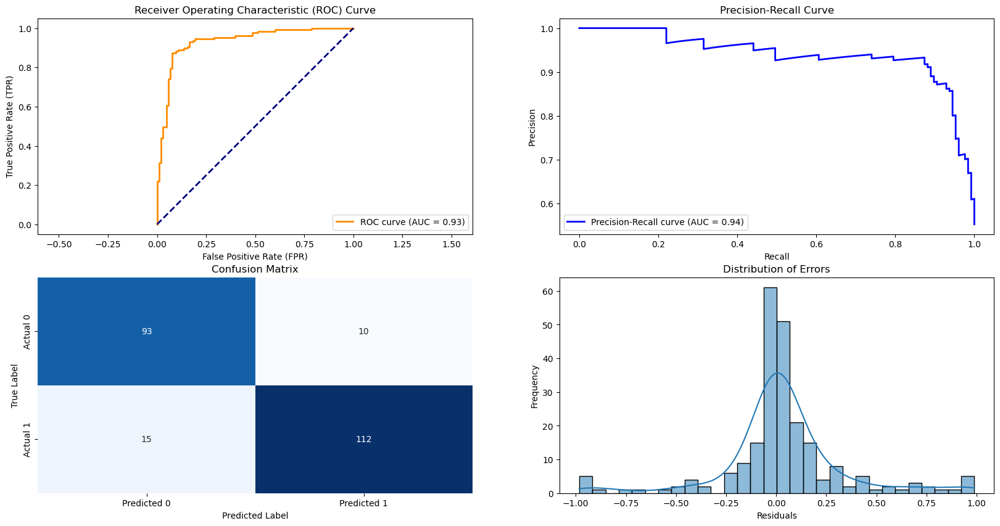

In [117]:
model = Model(best_gb_model, name='Gradient Boosting Undersample', scaled=True, resample='under')
model.fit()
model.visualize_metrics()

In [118]:
metrics_GBC_under = model.get_metrics()
models_df_under = pd.concat([models_df_under, metrics_GBC_under.to_frame().T])
print(metrics_GBC_under)

Accuracy                                 0.891304
Precision                                0.918033
Recall                                    0.88189
F1-Score                                 0.899598
ROC AUC                                  0.933186
Confusion Matrix            [[93, 10], [15, 112]]
PR AUC                                   0.939933
Name                Gradient Boosting Undersample
dtype: object


## XGBoost
XGBoost builds upon the principles of traditional gradient boosting while introducing several enhancements and optimizations that make it a go-to choice for predictive modeling tasks.
It is characterised by improvements over GBM:
- XGBoost is known for its efficiency in optimizing against the loss function by utilizing the Hessian information, making it more efficient in training compared to GBM.

- It leverages parallel processing techniques and optimized algorithms to achieve faster training times and lower memory usage, making it ideal for large-scale datasets.

- XGBoost provides robust regularization capabilities, including L1 regularization (Lasso) and L2 regularization (Ridge), which help prevent overfitting and improve model generalization. L1 Regularization tries to minimize the feature weights or coefficients to zero (effectively becoming a feature selection), while L2 Regularization tries to shrink the coefficient evenly (help to deal with multicollinearity).  By implementing both regularizations, XGBoost could avoid overfitting better than the GBM.

- XGBoost offers built-in support for handling missing values during training and prediction, simplifying the preprocessing pipeline and reducing the need for manual imputation techniques.

### No Resample

In [119]:
param_dist = {
    'n_estimators': [500, 800, 1000],  
    'learning_rate': [0.01, 0.05, 0.1],  
    'max_depth': [5, 7, 9],  
    'subsample': [0.6, 0.8, 1.0],  
    'colsample_bytree': [0.6, 0.8, 1.0],  
    'gamma': [0, 0.1, 0.2, 0.3],  
    'reg_alpha': [0, 0.01, 0.1, 1],  
    'reg_lambda': [0, 0.01, 0.1, 1] 
}

xgb_model = XGBClassifier(objective='binary:logistic', use_label_encoder=False)

random_search = RandomizedSearchCV(
    estimator=xgb_model,
    param_distributions=param_dist,
    n_iter=50,  
    scoring='roc_auc',  
    cv=4,  
    verbose=1,
    random_state=42,
    n_jobs=-1  
)
random_search.fit(X_train_scaled, y_train)
best_xgb_model = random_search.best_estimator_

Fitting 4 folds for each of 50 candidates, totalling 200 fits


/home/tony/anaconda3/lib/python3.12/site-packages/xgboost/core.py:158: UserWarning: [15:49:50] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)
/home/tony/anaconda3/lib/python3.12/site-packages/xgboost/core.py:158: UserWarning: [15:49:50] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)
/home/tony/anaconda3/lib/python3.12/site-packages/xgboost/core.py:158: UserWarning: [15:49:50] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)
/home/tony/anaconda3/lib/python3.12/site-packages/xgboost/core.py:158: UserWarning: [15:49:50] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)
/home/tony/anaconda3/lib/python3.12/site-packages/xgboost/core.py:158: UserWarning: [15:49:50] WARNING: /workspa

/home/tony/anaconda3/lib/python3.12/site-packages/xgboost/core.py:158: UserWarning: [15:50:03] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)


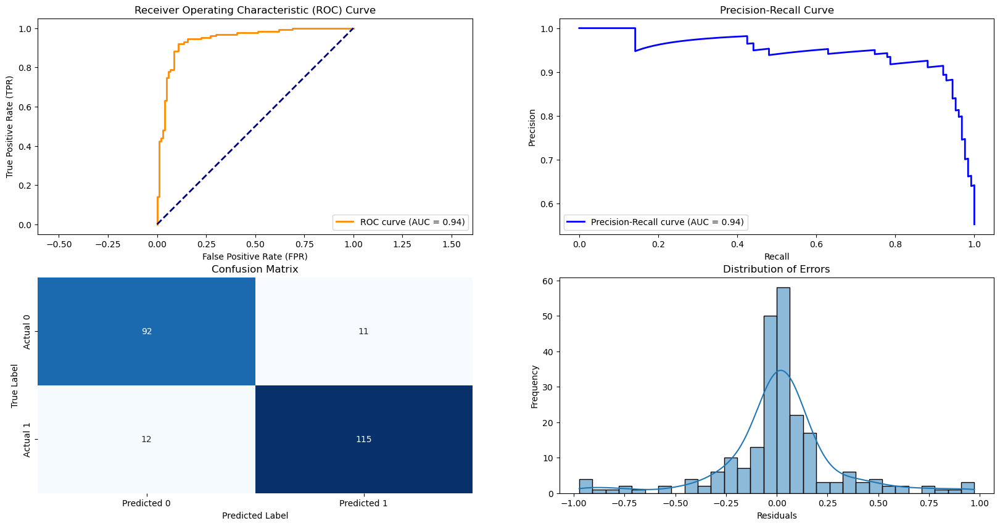

In [120]:
model = Model(best_xgb_model, name='XGB No Resample',
               scaled=True, resample=None)
model.fit()
model.visualize_metrics()

In [121]:
metrics_XG_no_resample = model.get_metrics()
models_df = pd.concat([models_df, metrics_XG_no_resample.to_frame().T])
print(metrics_XG_no_resample)

Accuracy                              0.9
Precision                        0.912698
Recall                           0.905512
F1-Score                         0.909091
ROC AUC                          0.942053
Confusion Matrix    [[92, 11], [12, 115]]
PR AUC                           0.944958
Name                      XGB No Resample
dtype: object


### SMOTE

In [122]:
param_dist = {
    'n_estimators': [500, 800, 1000],  
    'learning_rate': [0.01, 0.05, 0.1],  
    'max_depth': [5, 7, 9],  
    'subsample': [0.6, 0.8, 1.0],  
    'colsample_bytree': [0.6, 0.8, 1.0],  
    'gamma': [0, 0.1, 0.2, 0.3],  
    'reg_alpha': [0, 0.01, 0.1, 1],  
    'reg_lambda': [0, 0.01, 0.1, 1]  
}

xgb_model = XGBClassifier(objective='binary:logistic', use_label_encoder=False)

random_search = RandomizedSearchCV(
    estimator=xgb_model,
    param_distributions=param_dist,
    n_iter=50,  
    scoring='roc_auc',  
    cv=4,  
    verbose=1,
    random_state=42,
    n_jobs=-1 
)

random_search.fit(X_train_smote_scaled, y_train_smote)
best_xgb_model = random_search.best_estimator_

Fitting 4 folds for each of 50 candidates, totalling 200 fits


/home/tony/anaconda3/lib/python3.12/site-packages/xgboost/core.py:158: UserWarning: [15:50:11] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)
/home/tony/anaconda3/lib/python3.12/site-packages/xgboost/core.py:158: UserWarning: [15:50:11] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)
/home/tony/anaconda3/lib/python3.12/site-packages/xgboost/core.py:158: UserWarning: [15:50:11] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)
/home/tony/anaconda3/lib/python3.12/site-packages/xgboost/core.py:158: UserWarning: [15:50:11] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)
/home/tony/anaconda3/lib/python3.12/site-packages/xgboost/core.py:158: UserWarning: [15:50:11] WARNING: /workspa

/home/tony/anaconda3/lib/python3.12/site-packages/xgboost/core.py:158: UserWarning: [15:50:19] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)


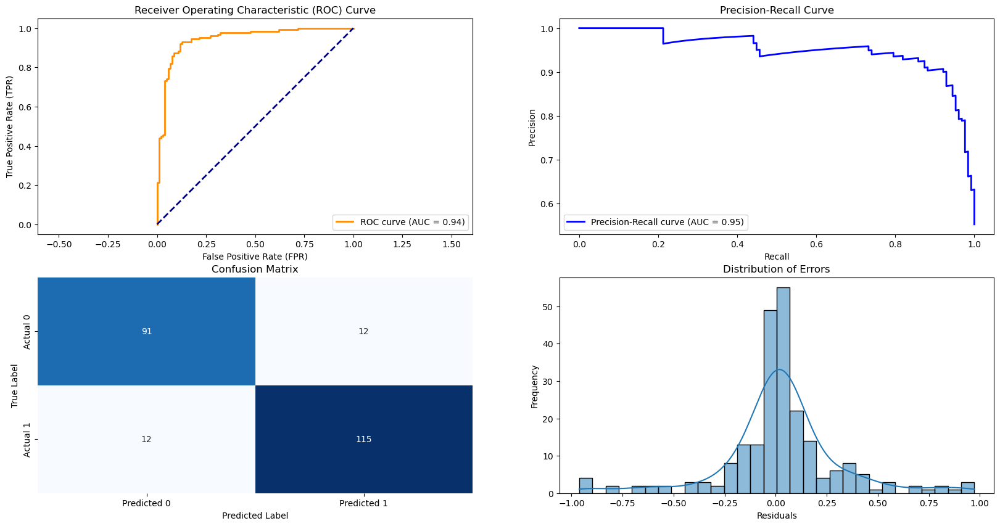

In [123]:
model = Model(best_xgb_model, name='XGB Smote',
               scaled=True, resample='smote')
model.fit()
model.visualize_metrics()

In [124]:
metrics_XG_smote = model.get_metrics()
models_df_smote = pd.concat([models_df_smote, metrics_XG_smote.to_frame().T])
print(metrics_XG_smote)

Accuracy                         0.895652
Precision                        0.905512
Recall                           0.905512
F1-Score                         0.905512
ROC AUC                          0.944805
Confusion Matrix    [[91, 12], [12, 115]]
PR AUC                           0.949808
Name                            XGB Smote
dtype: object


### Undersample

In [125]:
param_dist = {
    'n_estimators': [500, 800, 1000],  
    'learning_rate': [0.01, 0.05, 0.1],  
    'max_depth': [5, 7, 9],  
    'subsample': [0.6, 0.8, 1.0],  
    'colsample_bytree': [0.6, 0.8, 1.0],  
    'gamma': [0, 0.1, 0.2, 0.3],  
    'reg_alpha': [0, 0.01, 0.1, 1],  
    'reg_lambda': [0, 0.01, 0.1, 1]  
}

xgb_model = XGBClassifier(objective='binary:logistic', use_label_encoder=False)

random_search = RandomizedSearchCV(
    estimator=xgb_model,
    param_distributions=param_dist,
    n_iter=50,  
    scoring='roc_auc',  
    cv=4,  
    verbose=1,
    random_state=42,
    n_jobs=-1  
)

random_search.fit(X_train_under_scaled, y_train_under)
best_xgb_model = random_search.best_estimator_

Fitting 4 folds for each of 50 candidates, totalling 200 fits


/home/tony/anaconda3/lib/python3.12/site-packages/xgboost/core.py:158: UserWarning: [15:50:26] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)
/home/tony/anaconda3/lib/python3.12/site-packages/xgboost/core.py:158: UserWarning: [15:50:26] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)
/home/tony/anaconda3/lib/python3.12/site-packages/xgboost/core.py:158: UserWarning: [15:50:26] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)
/home/tony/anaconda3/lib/python3.12/site-packages/xgboost/core.py:158: UserWarning: [15:50:26] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)
/home/tony/anaconda3/lib/python3.12/site-packages/xgboost/core.py:158: UserWarning: [15:50:26] WARNING: /workspa

/home/tony/anaconda3/lib/python3.12/site-packages/xgboost/core.py:158: UserWarning: [15:50:38] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)


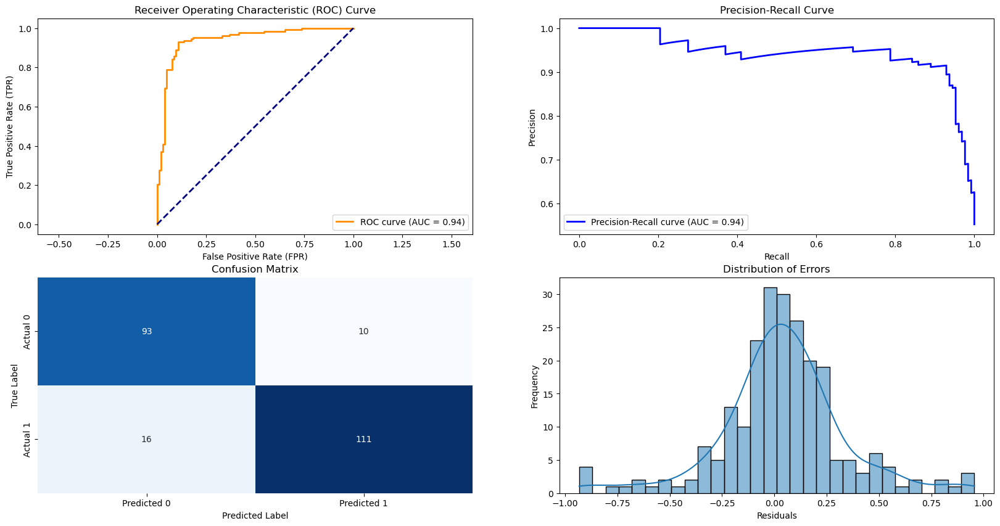

In [126]:
model = Model(best_xgb_model, name='XGB Undersample',
               scaled=True, resample='under')
model.fit()
model.visualize_metrics()

In [127]:
metrics_XG_under = model.get_metrics()
models_df_under = pd.concat([models_df_under, metrics_XG_under.to_frame().T])
print(metrics_XG_under)

Accuracy                         0.886957
Precision                        0.917355
Recall                           0.874016
F1-Score                         0.895161
ROC AUC                          0.939913
Confusion Matrix    [[93, 10], [16, 111]]
PR AUC                           0.943097
Name                      XGB Undersample
dtype: object


## CatBoost
Catboost is a variant of gradient boosting that can handle both categorical and numerical features. It does not require any feature encodings techniques like One-Hot Encoder or Label Encoder to convert categorical features into numerical features. It also uses an algorithm called symmetric weighted quantile sketch(SWQS) which automatically handles the missing values in the dataset to reduce overfitting and improve the overall performance of the dataset. 

The main difference from XGB is that CatBoost uses *Symmetric tree growth*, wherease in XGB and GBC trees are grown *level-wise*. Symmetric trees are grown by splitting all leaves at the same depth identically

### No Resample

In [128]:

model = cb.CatBoostClassifier()

param_grid = {
    'iterations': [500, 800],
    'learning_rate': [0.01, 0.1],
    'depth': [6, 8],
    'l2_leaf_reg': [1, 3],
}

random_search = RandomizedSearchCV(model, 
                                   param_distributions=param_grid, 
                                   n_iter=50, 
                                   cv=3, 
                                   scoring='roc_auc', 
                                   n_jobs=-1, 
                                   random_state=42)

random_search.fit(X_train_scaled, y_train)

best_model = random_search.best_estimator_

/home/tony/anaconda3/lib/python3.12/site-packages/sklearn/model_selection/_search.py:320: UserWarning: The total space of parameters 16 is smaller than n_iter=50. Running 16 iterations. For exhaustive searches, use GridSearchCV.
  warnings.warn(


0:	learn: 0.5925557	total: 55ms	remaining: 27.4s
1:	learn: 0.5195594	total: 56.6ms	remaining: 14.1s
0:	learn: 0.6822704	total: 56.7ms	remaining: 28.3s
2:	learn: 0.4671562	total: 58ms	remaining: 9.61s
1:	learn: 0.6716029	total: 57.9ms	remaining: 14.4s
0:	learn: 0.6824605	total: 59ms	remaining: 29.4s
2:	learn: 0.6630768	total: 59.1ms	remaining: 9.79s
3:	learn: 0.4322070	total: 59.9ms	remaining: 7.43s
3:	learn: 0.6548774	total: 60.1ms	remaining: 7.46s
1:	learn: 0.6719318	total: 60.3ms	remaining: 15s
4:	learn: 0.3936860	total: 61ms	remaining: 6.04s
0:	learn: 0.6830739	total: 59.1ms	remaining: 29.5s
4:	learn: 0.6432345	total: 61.1ms	remaining: 6.05s
2:	learn: 0.6639276	total: 61.7ms	remaining: 10.2s
5:	learn: 0.3598650	total: 62.1ms	remaining: 5.12s
1:	learn: 0.6742645	total: 60.4ms	remaining: 15.1s
6:	learn: 0.3420069	total: 63.5ms	remaining: 4.47s
7:	learn: 0.3207112	total: 64.7ms	remaining: 3.98s
8:	learn: 0.3020662	total: 65.8ms	remaining: 3.59s
9:	learn: 0.2885316	total: 66.9ms	remaini

0:	learn: 0.6832693	total: 1.74ms	remaining: 870ms
1:	learn: 0.6751037	total: 2.94ms	remaining: 733ms
2:	learn: 0.6669689	total: 3.96ms	remaining: 656ms
3:	learn: 0.6583682	total: 4.91ms	remaining: 609ms
4:	learn: 0.6489712	total: 5.89ms	remaining: 583ms
5:	learn: 0.6402779	total: 6.92ms	remaining: 570ms
6:	learn: 0.6319105	total: 7.94ms	remaining: 559ms
7:	learn: 0.6254054	total: 8.79ms	remaining: 541ms
8:	learn: 0.6170834	total: 9.89ms	remaining: 540ms
9:	learn: 0.6094539	total: 10.9ms	remaining: 535ms
10:	learn: 0.6027718	total: 11.8ms	remaining: 527ms
11:	learn: 0.5962220	total: 12.7ms	remaining: 518ms
12:	learn: 0.5896313	total: 13.6ms	remaining: 511ms
13:	learn: 0.5822531	total: 14.6ms	remaining: 506ms
14:	learn: 0.5759456	total: 15.4ms	remaining: 498ms
15:	learn: 0.5701814	total: 16.3ms	remaining: 492ms
16:	learn: 0.5654069	total: 17.2ms	remaining: 487ms
17:	learn: 0.5597287	total: 18.1ms	remaining: 484ms
18:	learn: 0.5540478	total: 18.9ms	remaining: 478ms
19:	learn: 0.5489431	t

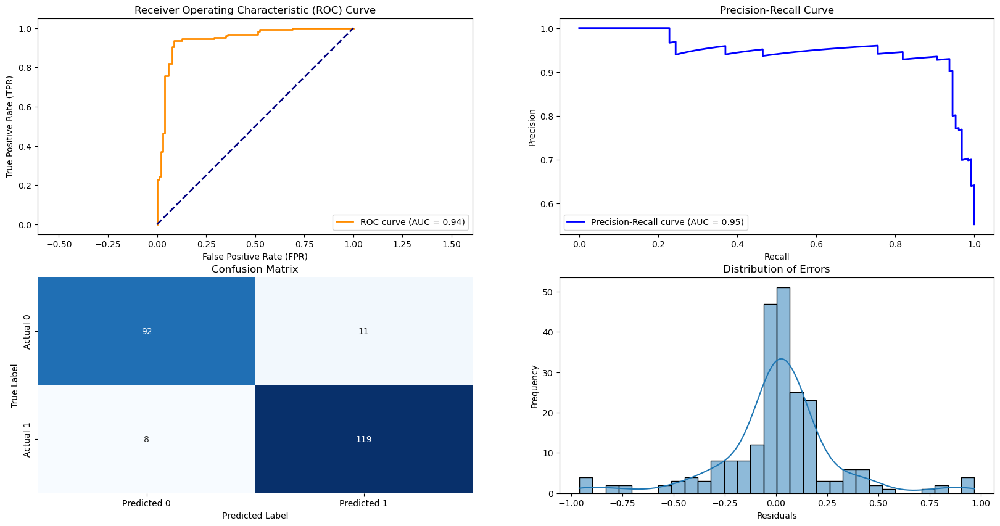

In [129]:
model = Model(best_model, 
              name='CatBoost No Resample', scaled=True, resample=None)
model.fit()
model.visualize_metrics()

In [130]:
metrics_CB_no_resample = model.get_metrics()
models_df = pd.concat([models_df, metrics_CB_no_resample.to_frame().T])
print(metrics_CB_no_resample)

Accuracy                        0.917391
Precision                       0.915385
Recall                          0.937008
F1-Score                         0.92607
ROC AUC                         0.943659
Confusion Matrix    [[92, 11], [8, 119]]
PR AUC                          0.946351
Name                CatBoost No Resample
dtype: object


### SMOTE

In [131]:

model = cb.CatBoostClassifier()


param_grid = {
    'iterations': [500, 800],
    'learning_rate': [0.01, 0.1],
    'depth': [6, 8],
    'l2_leaf_reg': [1, 3],
}


random_search = RandomizedSearchCV(model, 
                                   param_distributions=param_grid, 
                                   n_iter=50, cv=3, scoring='roc_auc', n_jobs=-1, random_state=42)

random_search.fit(X_train_smote_scaled, y_train_smote)


best_model = random_search.best_estimator_

/home/tony/anaconda3/lib/python3.12/site-packages/sklearn/model_selection/_search.py:320: UserWarning: The total space of parameters 16 is smaller than n_iter=50. Running 16 iterations. For exhaustive searches, use GridSearchCV.
  warnings.warn(


0:	learn: 0.6855091	total: 1.45ms	remaining: 725ms
1:	learn: 0.6766758	total: 2.73ms	remaining: 679ms
0:	learn: 0.6826991	total: 1.95ms	remaining: 973ms
2:	learn: 0.6675559	total: 4.13ms	remaining: 685ms
3:	learn: 0.6596567	total: 5.38ms	remaining: 667ms
4:	learn: 0.6490509	total: 6.6ms	remaining: 653ms
1:	learn: 0.6725663	total: 4.95ms	remaining: 1.23s
2:	learn: 0.6635025	total: 6.46ms	remaining: 1.07s
5:	learn: 0.6405148	total: 8.76ms	remaining: 721ms
0:	learn: 0.6224985	total: 2.86ms	remaining: 1.43s
3:	learn: 0.6554419	total: 9.45ms	remaining: 1.17s
6:	learn: 0.6321018	total: 9.94ms	remaining: 700ms
7:	learn: 0.6259901	total: 10.9ms	remaining: 670ms
4:	learn: 0.6456484	total: 10.8ms	remaining: 1.06s
5:	learn: 0.6365174	total: 11.9ms	remaining: 977ms
6:	learn: 0.6276709	total: 13ms	remaining: 915ms
7:	learn: 0.6229037	total: 14ms	remaining: 861ms
8:	learn: 0.6173430	total: 15.5ms	remaining: 844ms
8:	learn: 0.6148325	total: 15.1ms	remaining: 824ms
9:	learn: 0.6080823	total: 16.5ms	re

0:	learn: 0.6834041	total: 1.91ms	remaining: 951ms
1:	learn: 0.6754307	total: 3.23ms	remaining: 805ms
2:	learn: 0.6658271	total: 4.46ms	remaining: 739ms
3:	learn: 0.6583348	total: 5.65ms	remaining: 701ms
4:	learn: 0.6502155	total: 6.84ms	remaining: 677ms
5:	learn: 0.6424716	total: 8.06ms	remaining: 663ms
6:	learn: 0.6341106	total: 9.22ms	remaining: 650ms
7:	learn: 0.6269921	total: 10.1ms	remaining: 621ms
8:	learn: 0.6194780	total: 11.2ms	remaining: 612ms
9:	learn: 0.6112411	total: 12.4ms	remaining: 607ms
10:	learn: 0.6044951	total: 13.6ms	remaining: 603ms
11:	learn: 0.5981448	total: 14.8ms	remaining: 600ms
12:	learn: 0.5908774	total: 16ms	remaining: 600ms
13:	learn: 0.5850889	total: 17.3ms	remaining: 602ms
14:	learn: 0.5789534	total: 18.6ms	remaining: 601ms
15:	learn: 0.5732651	total: 19.8ms	remaining: 599ms
16:	learn: 0.5673909	total: 21ms	remaining: 596ms
17:	learn: 0.5613228	total: 22.1ms	remaining: 590ms
18:	learn: 0.5549158	total: 23.1ms	remaining: 586ms
19:	learn: 0.5494715	total

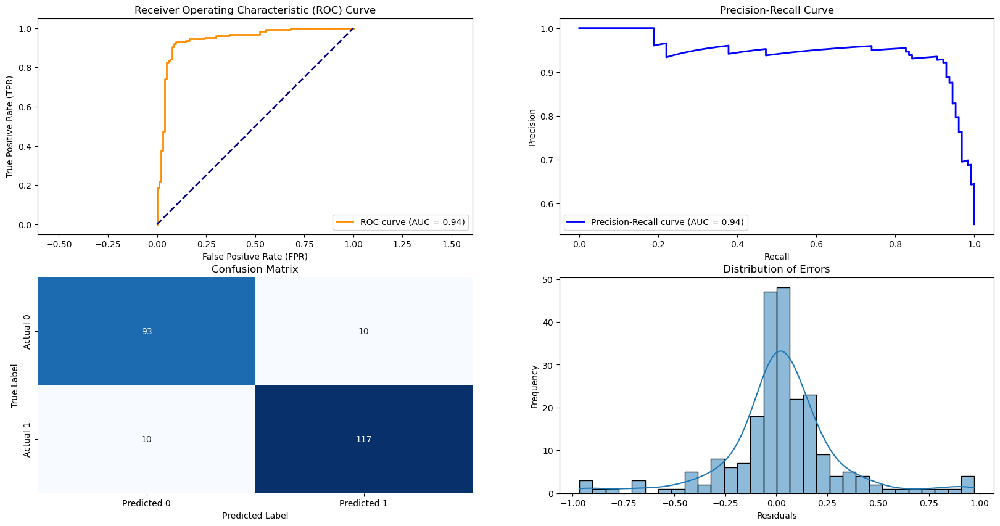

In [132]:
model = Model(best_model, 
              name='CatBoost SMOTE', scaled=True, resample='smote')
model.fit()
model.visualize_metrics()

In [133]:
metrics_CB_smote = model.get_metrics()
models_df_smote = pd.concat([models_df_smote, metrics_CB_smote.to_frame().T])
print(metrics_CB_smote)

Accuracy                         0.913043
Precision                         0.92126
Recall                            0.92126
F1-Score                          0.92126
ROC AUC                          0.943659
Confusion Matrix    [[93, 10], [10, 117]]
PR AUC                           0.944958
Name                       CatBoost SMOTE
dtype: object


### Undersample

In [134]:

model = cb.CatBoostClassifier()

param_grid = {
    'iterations': [500, 800],
    'learning_rate': [0.01, 0.1],
    'depth': [6, 8],
    'l2_leaf_reg': [1, 3],
}


random_search = RandomizedSearchCV(model, 
                                   param_distributions=param_grid, 
                                   n_iter=50, cv=3, scoring='roc_auc', n_jobs=-1, random_state=42)


random_search.fit(X_train_under_scaled, y_train_under)


best_model = random_search.best_estimator_

/home/tony/anaconda3/lib/python3.12/site-packages/sklearn/model_selection/_search.py:320: UserWarning: The total space of parameters 16 is smaller than n_iter=50. Running 16 iterations. For exhaustive searches, use GridSearchCV.
  warnings.warn(


0:	learn: 0.6819794	total: 2.75ms	remaining: 1.37s
0:	learn: 0.6816400	total: 2.81ms	remaining: 1.4s
1:	learn: 0.6713926	total: 3.78ms	remaining: 942ms
1:	learn: 0.6708255	total: 3.8ms	remaining: 947ms
2:	learn: 0.6618529	total: 5.16ms	remaining: 854ms
3:	learn: 0.6554006	total: 6.07ms	remaining: 753ms
0:	learn: 0.6814114	total: 4.64ms	remaining: 2.32s
4:	learn: 0.6469536	total: 7.08ms	remaining: 701ms
5:	learn: 0.6388705	total: 7.96ms	remaining: 656ms
6:	learn: 0.6312507	total: 8.82ms	remaining: 621ms
2:	learn: 0.6637527	total: 9.48ms	remaining: 1.57s
7:	learn: 0.6233278	total: 9.54ms	remaining: 587ms
3:	learn: 0.6527106	total: 10.4ms	remaining: 1.29s
8:	learn: 0.6141121	total: 10.5ms	remaining: 572ms
4:	learn: 0.6418150	total: 11.7ms	remaining: 1.16s
9:	learn: 0.6049071	total: 11.4ms	remaining: 558ms
10:	learn: 0.5970375	total: 12.2ms	remaining: 543ms
11:	learn: 0.5911386	total: 13ms	remaining: 529ms
0:	learn: 0.6827436	total: 3.1ms	remaining: 1.55s
5:	learn: 0.6318325	total: 14.5ms	

0:	learn: 0.6831050	total: 1.77ms	remaining: 885ms
1:	learn: 0.6744891	total: 2.96ms	remaining: 736ms
2:	learn: 0.6661689	total: 3.81ms	remaining: 631ms
3:	learn: 0.6574893	total: 4.67ms	remaining: 579ms
4:	learn: 0.6489440	total: 5.57ms	remaining: 552ms
5:	learn: 0.6412584	total: 6.5ms	remaining: 536ms
6:	learn: 0.6330247	total: 7.45ms	remaining: 525ms
7:	learn: 0.6262871	total: 8.26ms	remaining: 508ms
8:	learn: 0.6180174	total: 9.29ms	remaining: 507ms
9:	learn: 0.6102702	total: 10.2ms	remaining: 500ms
10:	learn: 0.6026997	total: 11.3ms	remaining: 501ms
11:	learn: 0.5958517	total: 12.2ms	remaining: 496ms
12:	learn: 0.5892903	total: 13.1ms	remaining: 489ms
13:	learn: 0.5825829	total: 13.9ms	remaining: 483ms
14:	learn: 0.5765262	total: 14.8ms	remaining: 479ms
15:	learn: 0.5707732	total: 15.7ms	remaining: 476ms
16:	learn: 0.5659115	total: 16.6ms	remaining: 472ms
17:	learn: 0.5603803	total: 17.5ms	remaining: 468ms
18:	learn: 0.5545534	total: 18.4ms	remaining: 466ms
19:	learn: 0.5495638	to

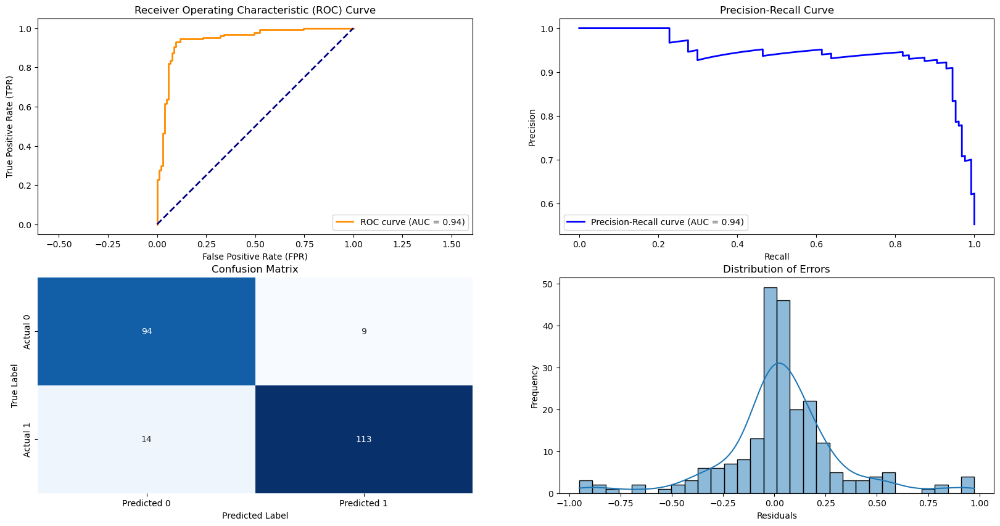

In [135]:
model = Model(best_model, 
              name='CatBoost Undersample', scaled=True, resample='under')
model.fit()
model.visualize_metrics()

In [136]:
metrics_CB_under = model.get_metrics()
models_df_under = pd.concat([models_df_under, metrics_CB_under.to_frame().T])
print(metrics_CB_under)

Accuracy                             0.9
Precision                        0.92623
Recall                          0.889764
F1-Score                        0.907631
ROC AUC                         0.940677
Confusion Matrix    [[94, 9], [14, 113]]
PR AUC                           0.94303
Name                CatBoost Undersample
dtype: object


## LightGBM
LightGBM stands for Light Gradient Boosting Machine, and it is designed to be fast and efficient. LightGBM has several advantages over other gradient boosting frameworks, such as XGBoost or CatBoost. Some of these advantages are:
- It supports categorical features directly, without the need for one-hot encoding or label encoding. (like CatBoost)

- It uses histogram-based algorithms, which reduce the number of split points and speed up the training process.

- It uses leaf-wise growth, which means it splits the tree by the leaf that has the maximum delta loss, rather than level-wise growth, which splits the tree by levels. This can result in better accuracy and lower overfitting.

- It supports parallel and distributed learning, which can scale up to large datasets and clusters.

### No Resample

In [137]:
from sklearn.model_selection import RandomizedSearchCV
import lightgbm as lgb

model = lgb.LGBMClassifier(objective="binary")

param_distributions = {
    'n_estimators': [500, 1000, 1500],
    'learning_rate': [0.01, 0.05, 0.1, 0.2],
    'max_depth': [6, 8, 10, 12],
    'num_leaves': [20, 31, 40, 50],
    'min_child_samples': [20, 30, 40],
    'subsample': [0.6, 0.8, 1.0],
    'colsample_bytree': [0.6, 0.8, 1.0],
    'reg_alpha': [0, 0.1, 0.5],
    'reg_lambda': [0, 0.1, 0.5]
}


random_search = RandomizedSearchCV(model, param_distributions, n_iter=50, cv=3, scoring='roc_auc', n_jobs=-1, random_state=42)


random_search.fit(X_train_scaled, y_train)


best_model_lgb = random_search.best_estimator_

[LightGBM] [Info] Number of positive: 254, number of negative: 205
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.008123 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 305
[LightGBM] [Info] Number of data points in the train set: 459, number of used features: 11
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.553377 -> initscore=0.214324
[LightGBM] [Info] Start training from score 0.214324
[LightGBM] [Info] Number of positive: 254, number of negative: 205
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.002817 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 305
[LightGBM] [Info] Number of positive: 254, number of negative: 204[LightGBM] [Info] Number of data points in the train set: 459, number of used features: 11

[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.553377 -> initscore=0.214324
[LightGBM] [Info

[LightGBM] [Info] Number of positive: 381, number of negative: 307
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000088 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 367
[LightGBM] [Info] Number of data points in the train set: 688, number of used features: 11
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.553779 -> initscore=0.215952
[LightGBM] [Info] Start training from score 0.215952
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

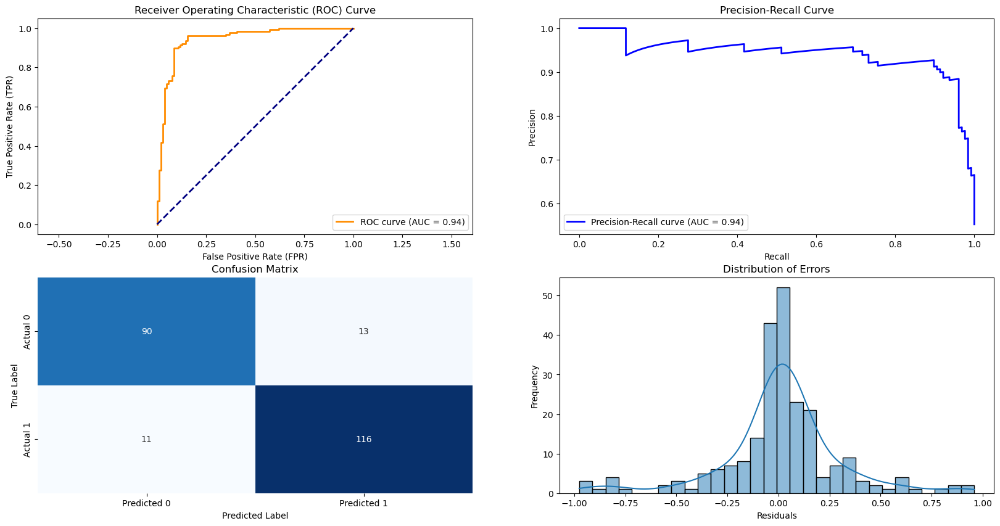

In [142]:
model = Model(best_model_lgb, 
              name='LightGBM No Resample', scaled=True, resample=None)
model.fit()
model.visualize_metrics()

In [143]:
metrics_lgb_no_resample = model.get_metrics()
models_df = pd.concat([models_df, metrics_lgb_no_resample.to_frame().T])
print(metrics_lgb_no_resample)

Accuracy                         0.895652
Precision                        0.899225
Recall                           0.913386
F1-Score                          0.90625
ROC AUC                          0.942665
Confusion Matrix    [[90, 13], [11, 116]]
PR AUC                            0.94132
Name                 LightGBM No Resample
dtype: object


### SMOTE

In [140]:

model = lgb.LGBMClassifier(objective="binary")


param_distributions = {
    'n_estimators': [500, 1000, 1500],
    'learning_rate': [0.01, 0.05, 0.1, 0.2],
    'max_depth': [6, 8, 10, 12],
    'num_leaves': [20, 31, 40, 50],
    'min_child_samples': [20, 30, 40],
    'subsample': [0.6, 0.8, 1.0],
    'colsample_bytree': [0.6, 0.8, 1.0],
    'reg_alpha': [0, 0.1, 0.5],
    'reg_lambda': [0, 0.1, 0.5]
}


random_search = RandomizedSearchCV(model, param_distributions, n_iter=50, cv=3, scoring='roc_auc', n_jobs=-1, random_state=42)

random_search.fit(X_train_smote_scaled, y_train_smote)

best_model_lgb = random_search.best_estimator_

[LightGBM] [Info] Number of positive: 254, number of negative: 254
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000057 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 338
[LightGBM] [Info] Number of data points in the train set: 508, number of used features: 11
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Number of positive: 254, number of negative: 254
[LightGBM] [Info] Number of positive: 254, number of negative: 254
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000810 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 319
[LightGBM] [Warning] No f

[LightGBM] [Info] Number of positive: 82189, number of negative: 82189
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.006463 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 3652
[LightGBM] [Info] Number of data points in the train set: 164378, number of used features: 17
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000


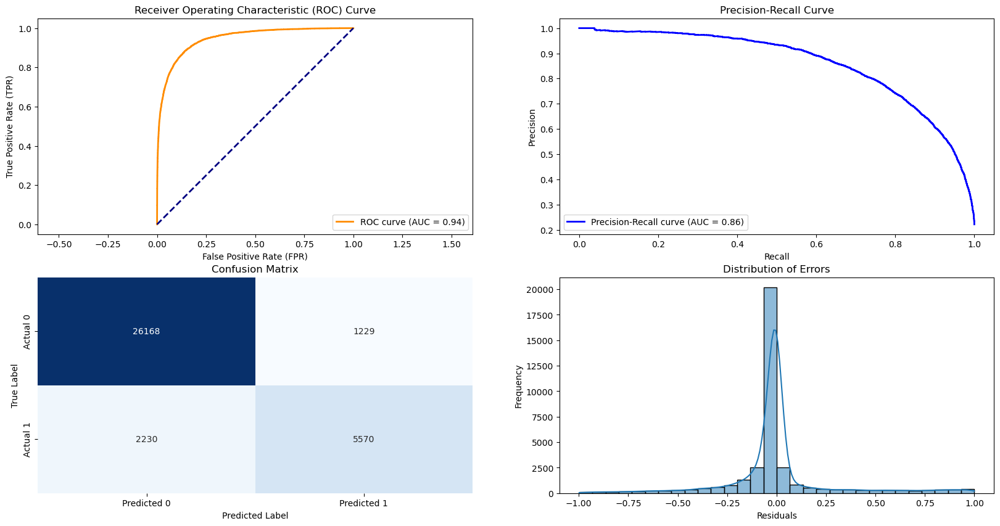

In [98]:
model = Model(best_model_lgb, 
              name='Ligth GBM SMOTE', scaled=True, resample='smote')
model.fit()
model.visualize_metrics()

In [99]:
metrics_lgb_smote = model.get_metrics()
models_df_smote = pd.concat([models_df_smote, metrics_lgb_smote.to_frame().T])
print(metrics_lgb_smote)

Accuracy                                 0.901725
Precision                                0.819238
Recall                                   0.714103
F1-Score                                 0.763066
ROC AUC                                  0.944573
Confusion Matrix    [[26168, 1229], [2230, 5570]]
PR AUC                                   0.860649
Name                              Ligth GBM SMOTE
dtype: object


### Undersample

In [ ]:

model = lgb.LGBMClassifier(objective="binary")

param_distributions = {
    'n_estimators': [500, 1000, 1500],
    'learning_rate': [0.01, 0.05, 0.1, 0.2],
    'max_depth': [6, 8, 10, 12],
    'num_leaves': [20, 31, 40, 50],
    'min_child_samples': [20, 30, 40],
    'subsample': [0.6, 0.8, 1.0],
    'colsample_bytree': [0.6, 0.8, 1.0],
    'reg_alpha': [0, 0.1, 0.5],
    'reg_lambda': [0, 0.1, 0.5]
}

random_search = RandomizedSearchCV(model, param_distributions, n_iter=50, cv=3, scoring='roc_auc', n_jobs=-1, random_state=42)

random_search.fit(X_train_under_scaled, y_train_under)

best_model_lgb = random_search.best_estimator_

[LightGBM] [Info] Number of positive: 23401, number of negative: 23401
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000854 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 3162
[LightGBM] [Info] Number of data points in the train set: 46802, number of used features: 17
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf


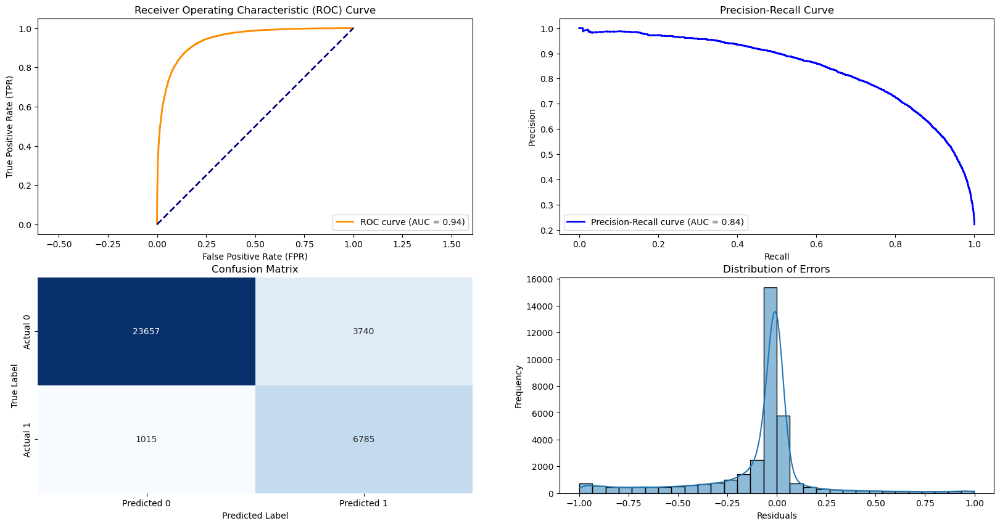

In [100]:
model = Model(best_model_lgb, 
              name='Ligth GBM Under', scaled=True, resample='under')
model.fit()
model.visualize_metrics()

In [101]:
metrics_lgb_under = model.get_metrics()
models_df_under = pd.concat([models_df_under, metrics_lgb_under.to_frame().T])
print(metrics_lgb_under)

Accuracy                                 0.864903
Precision                                0.644656
Recall                                   0.869872
F1-Score                                 0.740518
ROC AUC                                  0.941262
Confusion Matrix    [[23657, 3740], [1015, 6785]]
PR AUC                                   0.842884
Name                              Ligth GBM Under
dtype: object


## Neural Network

### No Resample

In [144]:
from tensorflow.keras.optimizers import Adam

model = Sequential([
    Input(shape=[X_train.shape[1]]),
    BatchNormalization(),
    Dense(128, activation='relu'),
    Dropout(0.3),
    Dense(96, activation='relu'),
    Dropout(0.3),
    Dense(64, activation='relu'),
    Dense(32, activation='relu'), 
    Dense(1, activation='sigmoid'),
])
optimizer = Adam(learning_rate=0.0001)
model.compile(
    optimizer=optimizer,
    loss='binary_crossentropy',
    metrics=['binary_accuracy'],
)

# Early stopping callback
early_stopping = EarlyStopping(
    monitor='val_loss',
    patience=10,
    restore_best_weights=True
)

# Model training
history = model.fit(
    X_train_scaled, y_train,
    validation_data=(X_test_scaled, y_test),
    batch_size=100,
    epochs=200,
    shuffle = True,
    callbacks=[early_stopping]
)

Epoch 1/200


2024-11-12 16:03:02.150234: E external/local_xla/xla/stream_executor/cuda/cuda_driver.cc:266] failed call to cuInit: CUDA_ERROR_NO_DEVICE: no CUDA-capable device is detected


7/7 ━━━━━━━━━━━━━━━━━━━━ 2s 32ms/step - binary_accuracy: 0.5860 - loss: 0.6641 - val_binary_accuracy: 0.6565 - val_loss: 0.6472
Epoch 2/200
7/7 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - binary_accuracy: 0.6081 - loss: 0.6568 - val_binary_accuracy: 0.7000 - val_loss: 0.6330
Epoch 3/200
7/7 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - binary_accuracy: 0.6487 - loss: 0.6436 - val_binary_accuracy: 0.7522 - val_loss: 0.6185
Epoch 4/200
7/7 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - binary_accuracy: 0.6827 - loss: 0.6315 - val_binary_accuracy: 0.7783 - val_loss: 0.6042
Epoch 5/200
7/7 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - binary_accuracy: 0.6783 - loss: 0.6173 - val_binary_accuracy: 0.7870 - val_loss: 0.5900
Epoch 6/200
7/7 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - binary_accuracy: 0.6803 - loss: 0.6047 - val_binary_accuracy: 0.8130 - val_loss: 0.5758
Epoch 7/200
7/7 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - binary_accuracy: 0.7149 - loss: 0.5983 - val_binary_accuracy: 0.8261 - val_loss: 0.5615
Epoch 8/200
7/7 ━━━━━━━━━━━━━━━━━━━━ 0

Best Validation Loss: 0.3500
Best Validation Accuracy: 0.8696


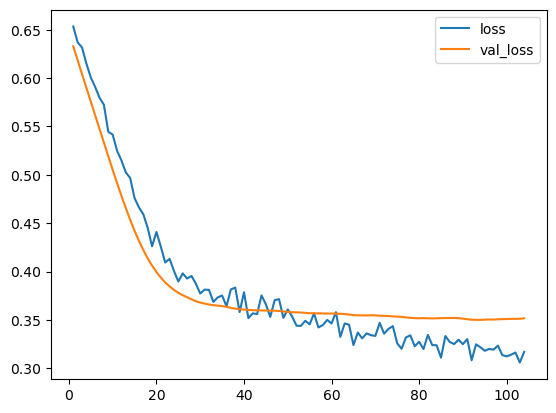

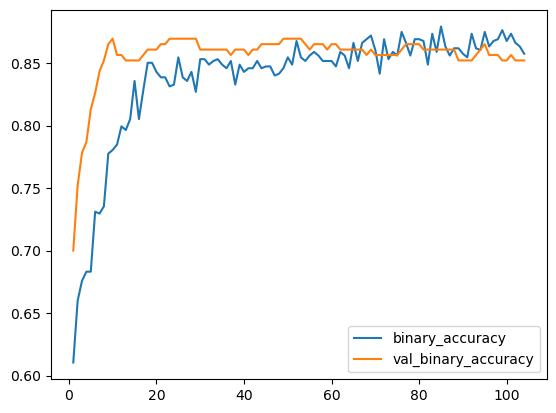

In [145]:
history_df = pd.DataFrame(history.history)

history_df.loc[1:, ['loss', 'val_loss']].plot()
history_df.loc[1:, ['binary_accuracy', 'val_binary_accuracy']].plot()

print(("Best Validation Loss: {:0.4f}" +\
      "\nBest Validation Accuracy: {:0.4f}")\
      .format(history_df['val_loss'].min(), 
              history_df['val_binary_accuracy'].max()))

In [146]:
y_pred_prob_test = model.predict(X_test_scaled)
y_pred_test = np.where(y_pred_prob_test.squeeze() < 0.5, 0, 1)
acc_test = metrics.accuracy_score(y_test, y_pred_test)
print(acc_test)

8/8 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step
0.8608695652173913


In [147]:
accuracy = metrics.accuracy_score(y_test, y_pred_test)
precision = metrics.precision_score(y_test, y_pred_test)
recall = metrics.recall_score(y_test, y_pred_test)
f1 = metrics.f1_score(y_test, y_pred_test)
roc_auc = metrics.roc_auc_score(y_test, y_pred_prob_test)
conf_mat = metrics.confusion_matrix(y_test, y_pred_test)
pr_auc = metrics.average_precision_score(y_test, y_pred_prob_test)
metrics_TF = pd.Series({
'Accuracy': accuracy,
'Precision': precision,
'Recall': recall,
'F1-Score': f1,
'ROC AUC': roc_auc,
'PR AUC': pr_auc,
'Confusion Matrix': conf_mat,
'Name':'NN No Resample'
})
print(metrics_TF)
models_df = pd.concat([models_df, metrics_TF.to_frame().T])

Accuracy                          0.86087
Precision                        0.862595
Recall                           0.889764
F1-Score                         0.875969
ROC AUC                           0.91889
PR AUC                            0.91771
Confusion Matrix    [[85, 18], [14, 113]]
Name                       NN No Resample
dtype: object


## SMOTE

In [148]:
from tensorflow.keras.regularizers import l2

model = Sequential([
    Input(shape=[X_train.shape[1]]),
    BatchNormalization(),
    Dense(256, activation='relu',  kernel_regularizer=l2(0.001)),
    Dropout(0.05),
    Dense(128, activation='relu', kernel_regularizer=l2(0.001)),
    Dropout(0.05),
    Dense(96, activation='relu', kernel_regularizer=l2(0.001)),
    Dense(64, activation='relu'),
    Dense(32, activation='relu'), 
    Dense(1, activation='sigmoid'),
])
optimizer = Adam(learning_rate=0.0001, clipnorm=1.0)
model.compile(
    optimizer=optimizer,
    loss='binary_crossentropy',
    metrics=['binary_accuracy'],
)

# Early stopping callback
early_stopping = EarlyStopping(
    monitor='val_loss',
    patience=10,
    restore_best_weights=True
)

# Model training
history = model.fit(
    X_train_smote_scaled, y_train_smote,
    validation_data=(X_test_smote_scaled, y_test),
    batch_size=1800,
    epochs=300,
    shuffle = True,
    callbacks=[early_stopping]
)

Epoch 1/300
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step - binary_accuracy: 0.5866 - loss: 0.9862 - val_binary_accuracy: 0.6304 - val_loss: 0.9854
Epoch 2/300
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 44ms/step - binary_accuracy: 0.6194 - loss: 0.9836 - val_binary_accuracy: 0.6783 - val_loss: 0.9813
Epoch 3/300
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 49ms/step - binary_accuracy: 0.6654 - loss: 0.9780 - val_binary_accuracy: 0.7043 - val_loss: 0.9773
Epoch 4/300
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 50ms/step - binary_accuracy: 0.6942 - loss: 0.9748 - val_binary_accuracy: 0.7435 - val_loss: 0.9734
Epoch 5/300
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 55ms/step - binary_accuracy: 0.6811 - loss: 0.9723 - val_binary_accuracy: 0.7565 - val_loss: 0.9695
Epoch 6/300
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 49ms/step - binary_accuracy: 0.7139 - loss: 0.9686 - val_binary_accuracy: 0.7609 - val_loss: 0.9656
Epoch 7/300
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 51ms/step - binary_accuracy: 0.7297 - loss: 0.9659 - val_binary_accuracy: 0.7957 - val_loss: 0.9616
Epoch 8/300
1/1 ━━━━━━

Best Validation Loss: 0.5813
Best Validation Accuracy: 0.8783


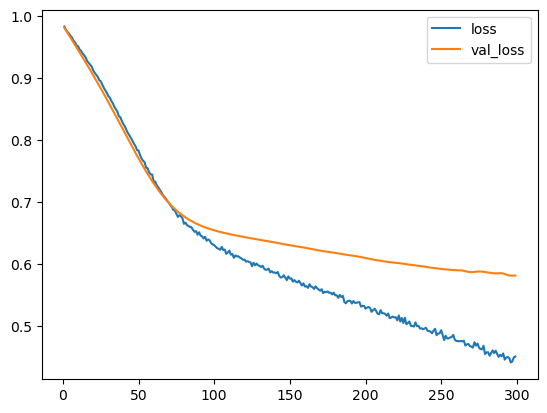

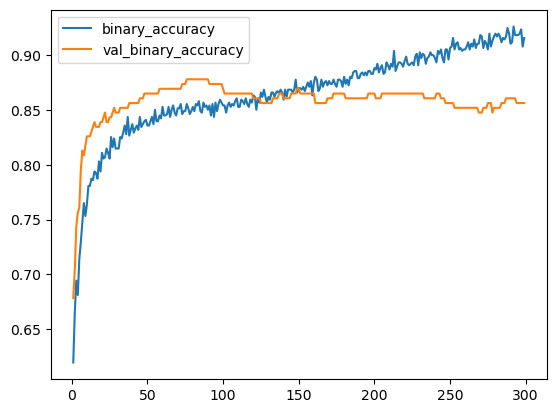

In [149]:
history_df = pd.DataFrame(history.history)

history_df.loc[1:, ['loss', 'val_loss']].plot()
history_df.loc[1:, ['binary_accuracy', 'val_binary_accuracy']].plot()

print(("Best Validation Loss: {:0.4f}" +\
      "\nBest Validation Accuracy: {:0.4f}")\
      .format(history_df['val_loss'].min(), 
              history_df['val_binary_accuracy'].max()))

In [150]:
y_pred_prob_test = model.predict(X_test_smote_scaled)
y_pred_test = np.where(y_pred_prob_test.squeeze() < 0.5, 0, 1)
acc_test = metrics.accuracy_score(y_test, y_pred_test)
print(acc_test)

8/8 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step
0.8565217391304348


In [151]:
accuracy = metrics.accuracy_score(y_test, y_pred_test)
precision = metrics.precision_score(y_test, y_pred_test)
recall = metrics.recall_score(y_test, y_pred_test)
f1 = metrics.f1_score(y_test, y_pred_test)
roc_auc = metrics.roc_auc_score(y_test, y_pred_prob_test)
conf_mat = metrics.confusion_matrix(y_test, y_pred_test)
pr_auc = metrics.average_precision_score(y_test, y_pred_prob_test)
metrics_TF = pd.Series({
'Accuracy': accuracy,
'Precision': precision,
'Recall': recall,
'F1-Score': f1,
'ROC AUC': roc_auc,
'PR AUC': pr_auc,
'Confusion Matrix': conf_mat,
'Name':'NN Smote'
})
print(metrics_TF)
models_df_smote = pd.concat([models_df_smote, metrics_TF.to_frame().T])

Accuracy                         0.856522
Precision                        0.867188
Recall                           0.874016
F1-Score                         0.870588
ROC AUC                          0.932192
PR AUC                           0.938001
Confusion Matrix    [[86, 17], [16, 111]]
Name                             NN Smote
dtype: object


## Undersample

In [152]:
model = Sequential([
    Input(shape=[X_train.shape[1]]),
    BatchNormalization(),
    Dense(96, activation='relu', kernel_regularizer=l2(0.001)),
    Dropout(0.2),
    Dense(64, activation='relu', kernel_regularizer=l2(0.001)),
    Dropout(0.2),
    Dense(32, activation='relu', kernel_regularizer=l2(0.001)), 
    Dropout(0.2),
    Dense(16, activation='relu', kernel_regularizer=l2(0.001)),
    Dense(1, activation='sigmoid'),
])
optimizer = Adam(learning_rate=0.0001)
model.compile(
    optimizer=optimizer,
    loss='binary_crossentropy',
    metrics=['binary_accuracy'],
)

# Early stopping callback
early_stopping = EarlyStopping(
    monitor='val_loss',
    patience=10,
    restore_best_weights=True
)

# Model training
history = model.fit(
    X_train_under_scaled, y_train_under,
    validation_data=(X_test_under_scaled, y_test),
    batch_size=30,
    epochs=200,
    callbacks=[early_stopping]
)

Epoch 1/200
21/21 ━━━━━━━━━━━━━━━━━━━━ 2s 12ms/step - binary_accuracy: 0.4187 - loss: 0.8652 - val_binary_accuracy: 0.3696 - val_loss: 0.8667
Epoch 2/200
21/21 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - binary_accuracy: 0.4316 - loss: 0.8599 - val_binary_accuracy: 0.4391 - val_loss: 0.8593
Epoch 3/200
21/21 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - binary_accuracy: 0.4404 - loss: 0.8501 - val_binary_accuracy: 0.5000 - val_loss: 0.8526
Epoch 4/200
21/21 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - binary_accuracy: 0.5475 - loss: 0.8446 - val_binary_accuracy: 0.5609 - val_loss: 0.8457
Epoch 5/200
21/21 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - binary_accuracy: 0.5957 - loss: 0.8417 - val_binary_accuracy: 0.6174 - val_loss: 0.8375
Epoch 6/200
21/21 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - binary_accuracy: 0.6101 - loss: 0.8346 - val_binary_accuracy: 0.6870 - val_loss: 0.8279
Epoch 7/200
21/21 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - binary_accuracy: 0.6663 - loss: 0.8233 - val_binary_accuracy: 0.7391 - val_loss: 0.8163
Epoch 8/200


Best Validation Loss: 0.4409
Best Validation Accuracy: 0.8739


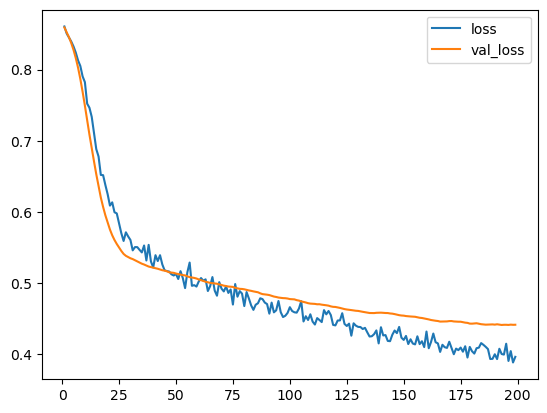

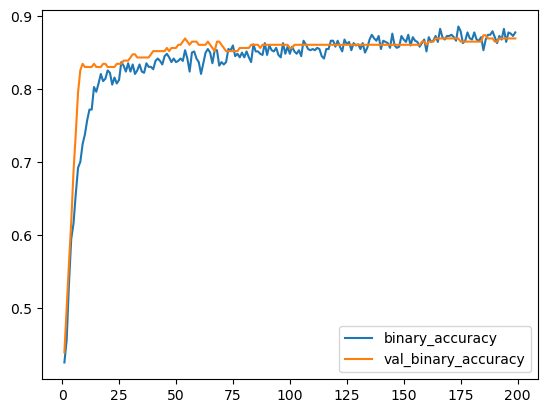

In [153]:
history_df = pd.DataFrame(history.history)

history_df.loc[1:, ['loss', 'val_loss']].plot()
history_df.loc[1:, ['binary_accuracy', 'val_binary_accuracy']].plot()

print(("Best Validation Loss: {:0.4f}" +\
      "\nBest Validation Accuracy: {:0.4f}")\
      .format(history_df['val_loss'].min(), 
              history_df['val_binary_accuracy'].max()))

In [154]:
y_pred_prob_test = model.predict(X_test_under_scaled)
y_pred_test = np.where(y_pred_prob_test.squeeze() < 0.5, 0, 1)
acc_test = metrics.accuracy_score(y_test, y_pred_test)
print(acc_test)

8/8 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step
0.8695652173913043


In [155]:
accuracy = metrics.accuracy_score(y_test, y_pred_test)
precision = metrics.precision_score(y_test, y_pred_test)
recall = metrics.recall_score(y_test, y_pred_test)
f1 = metrics.f1_score(y_test, y_pred_test)
roc_auc = metrics.roc_auc_score(y_test, y_pred_prob_test)
conf_mat = metrics.confusion_matrix(y_test, y_pred_test)
pr_auc = metrics.average_precision_score(y_test, y_pred_prob_test)
metrics_TF = pd.Series({
'Accuracy': accuracy,
'Precision': precision,
'Recall': recall,
'F1-Score': f1,
'ROC AUC': roc_auc,
'PR AUC': pr_auc,
'Confusion Matrix': conf_mat,
'Name':'NN Undersample'
})
print(metrics_TF)
models_df_under = pd.concat([models_df_under, metrics_TF.to_frame().T])

Accuracy                         0.869565
Precision                        0.870229
Recall                           0.897638
F1-Score                         0.883721
ROC AUC                          0.924929
PR AUC                           0.920782
Confusion Matrix    [[86, 17], [13, 114]]
Name                       NN Undersample
dtype: object


# Conclusion
Now for each type of work (No Resample, SMOTE and Undersample) and for each metric we find the best method

## No Resample

In [156]:
models_df

,Name,Accuracy,Precision,Recall,F1-Score,ROC AUC,Confusion Matrix,PR AUC
0,LDA No Resample,0.852174,0.866142,0.866142,0.866142,0.901766,"[[86, 17], [17, 110]]",0.890998
0,Logistic Regression No Resample,0.856522,0.867188,0.874016,0.870588,0.903677,"[[86, 17], [16, 111]]",0.896051
0,DT No Resample,0.834783,0.886957,0.80315,0.842975,0.896224,"[[90, 13], [25, 102]]",0.877686
0,RF No Resample,0.882609,0.890625,0.897638,0.894118,0.939951,"[[89, 14], [13, 114]]",0.928323
0,KNN No Resample,0.882609,0.896825,0.889764,0.893281,0.917399,"[[90, 13], [14, 113]]",0.900809
0,Gradient Boosting No Resample,0.9,0.919355,0.897638,0.908367,0.93846,"[[93, 10], [13, 114]]",0.944652
0,XGB No Resample,0.9,0.912698,0.905512,0.909091,0.942053,"[[92, 11], [12, 115]]",0.944958
0,CatBoost No Resample,0.917391,0.915385,0.937008,0.92607,0.943659,"[[92, 11], [8, 119]]",0.946351
0,LightGBM No Resample,0.9,0.912698,0.905512,0.909091,0.9419,"[[92, 11], [12, 115]]",0.941391
0,LightGBM No Resample,0.895652,0.899225,0.913386,0.90625,0.942665,"[[90, 13], [11, 116]]",0.94132


In [157]:
models_df.index = models_df.Name
models_df = models_df.drop('Name',axis=1)

<Axes: xlabel='Name'>

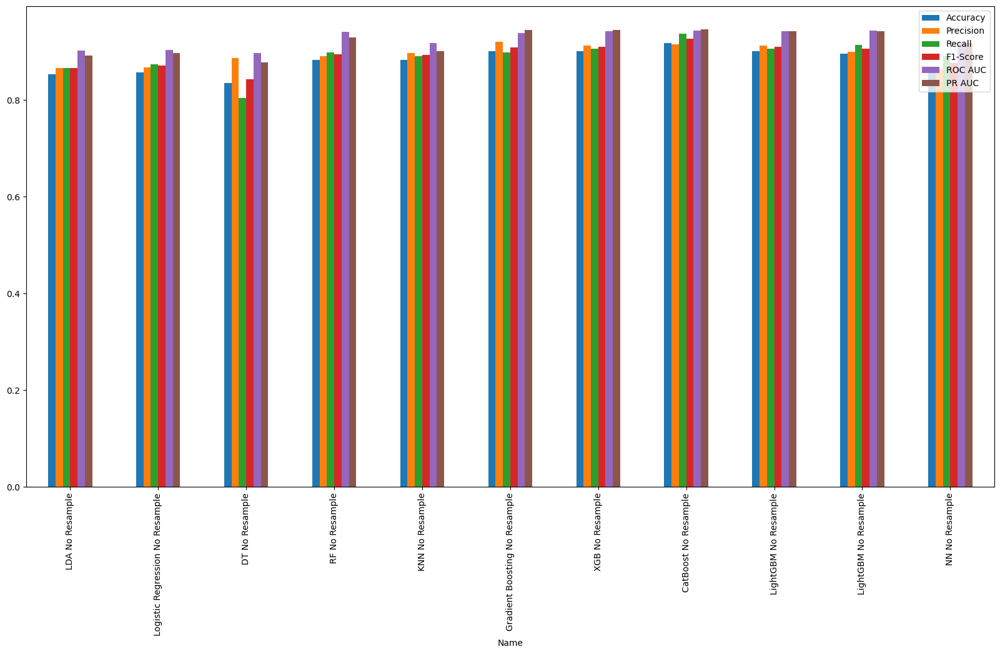

In [158]:
df = models_df[[x for x in models_df.columns if x != 'Confusion Matrix']]
df.plot.bar(figsize=(20,10))

In [159]:
best_values_no_resample = pd.DataFrame(columns=['Metric', 'Best Value', 'Method'])

for col in models_df.columns:
    if col != 'Confusion Matrix':
        best_value_row = models_df.sort_values(by=col, ascending=False).head(1)
        best_value = best_value_row[col].values[0]
        method_name = best_value_row.index[0]  
        new_row = pd.DataFrame({'Metric': [col], 'Best Value': [best_value], 'Method': [method_name]})
        best_values_no_resample = pd.concat([best_values_no_resample, new_row], ignore_index=True)

pd.DataFrame(best_values_no_resample)

,Metric,Best Value,Method
0,Accuracy,0.917391,CatBoost No Resample
1,Precision,0.919355,Gradient Boosting No Resample
2,Recall,0.937008,CatBoost No Resample
3,F1-Score,0.926070,CatBoost No Resample
4,ROC AUC,0.943659,CatBoost No Resample
5,PR AUC,0.946351,CatBoost No Resample


## SMOTE

In [160]:
models_df_smote

,Name,Accuracy,Precision,Recall,F1-Score,ROC AUC,Confusion Matrix,PR AUC
0,LDA SMOTE,0.856522,0.891667,0.84252,0.866397,0.906888,"[[90, 13], [20, 107]]",0.901241
0,Logistic Regression Smote,0.856522,0.879032,0.858268,0.868526,0.905359,"[[88, 15], [18, 109]]",0.899471
0,DT Smote,0.821739,0.858333,0.811024,0.834008,0.856395,"[[86, 17], [24, 103]]",0.822087
0,RF SMOTE,0.913043,0.92126,0.92126,0.92126,0.946984,"[[93, 10], [10, 117]]",0.94297
0,KNN SMOTE,0.891304,0.91129,0.889764,0.900398,0.919846,"[[92, 11], [14, 113]]",0.901904
0,Gradient Boosting SMOTE,0.886957,0.917355,0.874016,0.895161,0.936396,"[[93, 10], [16, 111]]",0.94519
0,XGB Smote,0.895652,0.905512,0.905512,0.905512,0.944805,"[[91, 12], [12, 115]]",0.949808
0,CatBoost SMOTE,0.913043,0.92126,0.92126,0.92126,0.943659,"[[93, 10], [10, 117]]",0.944958
0,NN Smote,0.856522,0.867188,0.874016,0.870588,0.932192,"[[86, 17], [16, 111]]",0.938001


In [161]:
models_df_smote.index = models_df_smote.Name
models_df_smote = models_df_smote.drop('Name',axis=1)

<Axes: xlabel='Name'>

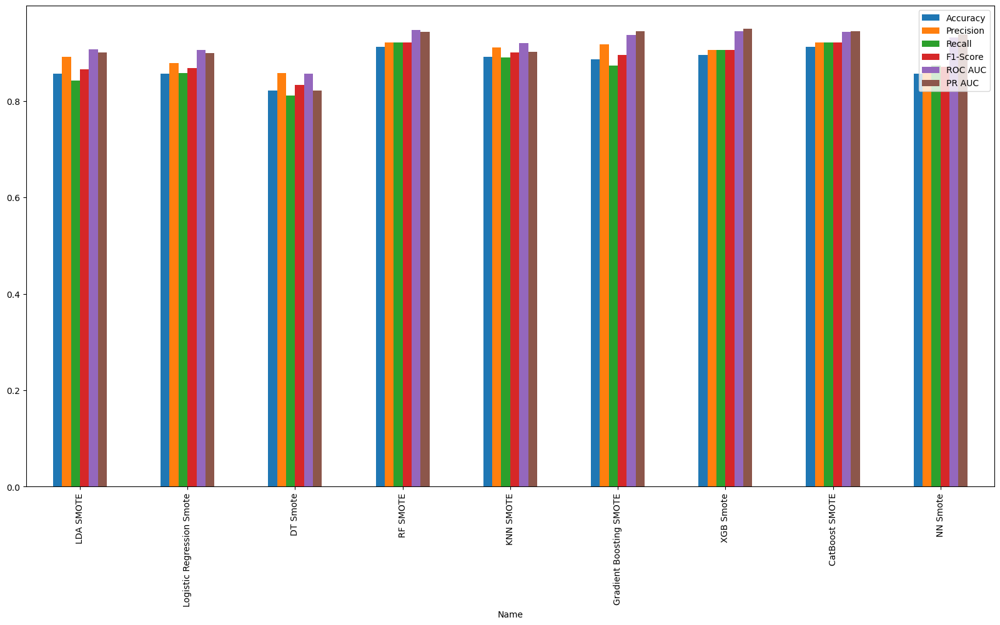

In [162]:
df_smote = models_df_smote[[x for x in models_df_smote.columns if x != 'Confusion Matrix']]
df_smote.plot.bar(figsize=(20,10))

In [163]:
best_values_smote = pd.DataFrame(columns=['Metric', 'Best Value', 'Method'])

for col in models_df_smote.columns:
    if col != 'Confusion Matrix':
        best_value_row = models_df_smote.sort_values(by=col, ascending=False).head(1)
        best_value = best_value_row[col].values[0]
        method_name = best_value_row.index[0]  
        new_row = pd.DataFrame({'Metric': [col], 'Best Value': [best_value], 'Method': [method_name]})
        best_values_smote = pd.concat([best_values_smote, new_row], ignore_index=True)

pd.DataFrame(best_values_smote)

,Metric,Best Value,Method
0,Accuracy,0.913043,RF SMOTE
1,Precision,0.921260,RF SMOTE
2,Recall,0.921260,RF SMOTE
3,F1-Score,0.921260,RF SMOTE
4,ROC AUC,0.946984,RF SMOTE
5,PR AUC,0.949808,XGB Smote


## Undersample

In [164]:
models_df_under

,Name,Accuracy,Precision,Recall,F1-Score,ROC AUC,Confusion Matrix,PR AUC
0,LDA undersample,0.86087,0.886179,0.858268,0.872,0.898555,"[[89, 14], [18, 109]]",0.887331
0,Logistic Regression Undersample,0.852174,0.884298,0.84252,0.862903,0.907423,"[[89, 14], [20, 107]]",0.904637
0,DT Undersample,0.843478,0.882353,0.826772,0.853659,0.909487,"[[89, 14], [22, 105]]",0.89755
0,RF Undersample,0.873913,0.895161,0.874016,0.884462,0.938422,"[[90, 13], [16, 111]]",0.942238
0,KNN Undersample,0.882609,0.903226,0.88189,0.89243,0.918202,"[[91, 12], [15, 112]]",0.901864
0,Gradient Boosting Undersample,0.891304,0.918033,0.88189,0.899598,0.933186,"[[93, 10], [15, 112]]",0.939933
0,XGB Undersample,0.886957,0.917355,0.874016,0.895161,0.939913,"[[93, 10], [16, 111]]",0.943097
0,CatBoost Undersample,0.9,0.92623,0.889764,0.907631,0.940677,"[[94, 9], [14, 113]]",0.94303
0,NN Undersample,0.869565,0.870229,0.897638,0.883721,0.924929,"[[86, 17], [13, 114]]",0.920782


In [165]:
models_df_under.index = models_df_under.Name
models_df_under = models_df_under.drop('Name',axis=1)

<Axes: xlabel='Name'>

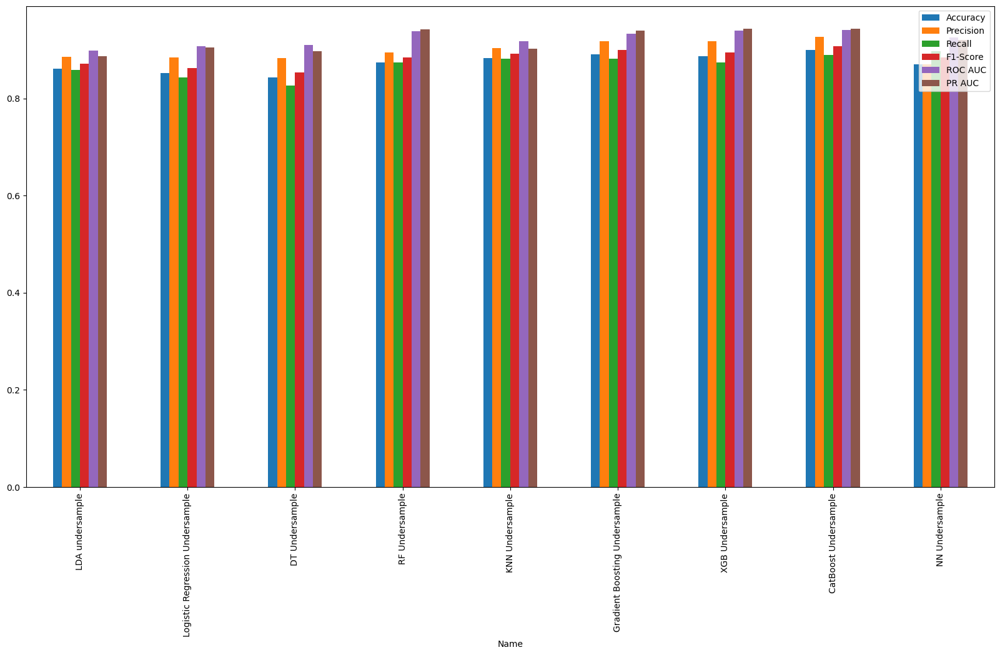

In [166]:
df_under = models_df_under[[x for x in models_df_under.columns if x != 'Confusion Matrix']]
df_under.plot.bar(figsize=(20,10))

In [167]:
best_values_under = pd.DataFrame(columns=['Metric', 'Best Value', 'Method'])

for col in models_df_under.columns:
    if col != 'Confusion Matrix':
        best_value_row = models_df_under.sort_values(by=col, ascending=False).head(1)
        best_value = best_value_row[col].values[0]
        method_name = best_value_row.index[0]  
        new_row = pd.DataFrame({'Metric': [col], 'Best Value': [best_value], 'Method': [method_name]})
        best_values_under = pd.concat([best_values_under, new_row], ignore_index=True)

pd.DataFrame(best_values_under)


,Metric,Best Value,Method
0,Accuracy,0.900000,CatBoost Undersample
1,Precision,0.926230,CatBoost Undersample
2,Recall,0.897638,NN Undersample
3,F1-Score,0.907631,CatBoost Undersample
4,ROC AUC,0.940677,CatBoost Undersample
5,PR AUC,0.943097,XGB Undersample


## Best method for each metrics
We can establish, for each metric, the best method among all runned. So, here I merged the three datasets and I don't make any differences between the three type of approach (No Resample, SMOTE, Undersample).

In [168]:

all_best_values = pd.concat([best_values_no_resample,
                             best_values_smote,
                             best_values_under],
                            ignore_index=True)

best_method_per_metric = all_best_values.loc[all_best_values.groupby('Metric')['Best Value'].idxmax()]

pd.DataFrame(best_method_per_metric)


,Metric,Best Value,Method
0,Accuracy,0.917391,CatBoost No Resample
3,F1-Score,0.926070,CatBoost No Resample
11,PR AUC,0.949808,XGB Smote
13,Precision,0.926230,CatBoost Undersample
10,ROC AUC,0.946984,RF SMOTE
2,Recall,0.937008,CatBoost No Resample


## Comparison of metrics for different sampling methods

In [169]:
recall_mean = [models_df['Recall'].mean(), models_df_smote['Recall'].mean(), models_df_under['Recall'].mean()]
precision_mean = [models_df['Precision'].mean(), models_df_smote['Precision'].mean(), models_df_under['Precision'].mean()]
pr_auc_mean = [models_df['PR AUC'].mean(), models_df_smote['PR AUC'].mean(), models_df_under['PR AUC'].mean()]
accuracy_mean = [models_df['Accuracy'].mean(), models_df_smote['Accuracy'].mean(), models_df_under['Accuracy'].mean()]
f1_mean = [models_df['F1-Score'].mean(), models_df_smote['F1-Score'].mean(), models_df_under['F1-Score'].mean()]

metrics_df = pd.DataFrame({
    'Method': ['Original', 'SMOTE', 'Under-sampling'],
    'Accuracy': accuracy_mean,
    'Recall': recall_mean,
    'Precision': precision_mean,
    'F1-Score': f1_mean,
    'PR AUC': pr_auc_mean
})

metrics_df

,Method,Accuracy,Recall,Precision,F1-Score,PR AUC
0,Original,0.880237,0.889048,0.893608,0.891086,0.920932
1,SMOTE,0.876812,0.877515,0.896989,0.887012,0.916181
2,Under-sampling,0.873430,0.869641,0.898118,0.883507,0.920051


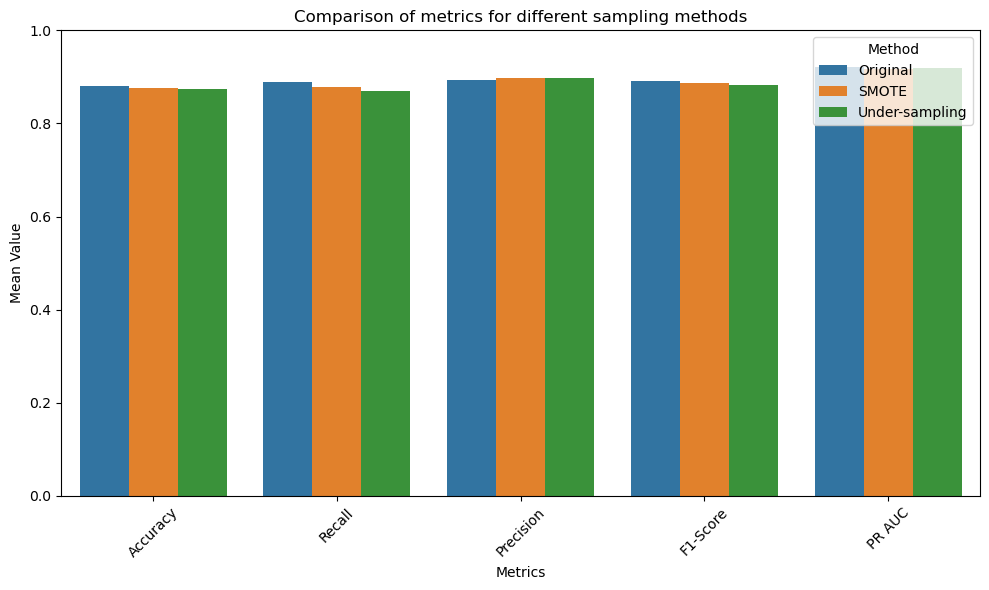

In [170]:

metrics_long_df = metrics_df.melt(id_vars='Method', var_name='Metric', value_name='Value')


plt.figure(figsize=(10, 6))
sns.barplot(x='Metric', y='Value', hue='Method', data=metrics_long_df)


plt.title('Comparison of metrics for different sampling methods')
plt.ylabel('Mean Value')
plt.xlabel('Metrics')
plt.ylim(0, 1) 
plt.legend(title='Method')
plt.xticks(rotation=45)


plt.tight_layout()
plt.show()